# Setup

In [1]:
# data handling packages
import pandas as pd
import numpy as np
import datetime as dt

# Machine Learning packages
import sklearn as sk
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import linkage, cophenet, dendrogram
from scipy.spatial.distance import pdist

# Visualization packages
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")




# Problem Statement and Background 

* Explore the data included with these instructions and prepare a 45 minute long presentation with recommendations and insights about the App Store

* You may discuss one or more of the suggested topics below in your presentation but they are only suggestions; present whatever you judge to be the most valuable and actionable information from your analysis:

  * Mocking up a business dashboard for tracking the App Store's performance
  * Grouping accounts into meaningfully different segments and analyzing their behavior
  * Grouping apps into meaningfully different segments
 
* Just like with real data there may be incorrect, suspect, or missing records. If you find a data quality issue please note it in your presentation but analyze the data to the best of your abilities as though there were no issues.

* You may use any means to perform your analysis and to draw insights from the data, such as Python, R, SQL, etc. Be prepared to share your work. If you build a model for any of your analysis, please share details on your selection and analysis.

* Your presentation should assume the audience includes data scientists and business stakeholders, so we recommend demonstrating your data science and technical skills, as well as presenting insights that would be of interest to both groups.

*  At the end of the presentation, there will be 15 mins for Q&A. We will ask questions to better understand your thought process as well as details of your analysis.

* Please send a PDF or link to your presentation. If you have a GitHub account, please check in your code and share the link with us.

# Prepare and Load the Data

**account_dat.csv**
 * acct_id - a unique ID associated with an account
 * create_dt - date the account was created
 * payment_type - 'Free' for accounts with no payment method, 'PMOF' for accounts with a payment method on file

**app_dat.csv**
 * app_name - the name of the app
 * content_id - a unique ID associated with a piece of content; all the content_ids in this table pertain to apps
 * category_id - an ID field that denotes the app's category (also called genre)
 * device_id - the device(s) where the app is available for purchase/download

**in-app_dat.csv**
 * parent_app_content_id - the content_id of the app where the in-app content can be purchased
 * content_id - a unique ID associated with a piece of content; all the content_ids in this table pertain to purchasable in-app content
 * type - the type of in-app content

**device_ref.csv** 
 * device_name - the name of the device
 * device_id - an ID field that denotes the type of device

**category_ref.csv**
 * category_name - the name of the category (also called genre)
 * category_id - an ID field that denotes the category of an app

**transaction_dat.csv**
 * create_dt - the date a transaction occurred
 * content_id - the content_id of the item that was purchased/downloaded
 * acct_id - the ID of the account making the purchase/download
 * price - the price paid in USD
 * device_id - the type of device where the content was downloaded/purchased

In [2]:
# Read CSV as pandas df

account_df = pd.read_csv('account_dat.csv')
app_df = pd.read_csv('app_dat.csv')
in_app_df = pd.read_csv('in-app_dat.csv')
device_ref_df = pd.read_csv('device_ref.csv')
category_df = pd.read_csv('category_ref.csv')

transaction_df = pd.read_csv('transaction_dat.csv')


In [3]:
# Examine the fields and their datatypes in each df

print('account_df dtypes:\n', account_df.dtypes, '\n')
print('app_df dtypes:\n', app_df.dtypes,'\n')
print('in_app_df dtypes:\n', in_app_df.dtypes,'\n')
print('device_ref_df dtypes:\n', device_ref_df.dtypes,'\n')
print('category_df dtypes:\n ', category_df.dtypes,'\n')
print('transaction_df dtypes:\n', transaction_df.dtypes,'\n')

account_df dtypes:
 acct_id         object
create_dt       object
payment_type    object
dtype: object 

app_df dtypes:
 app_name       object
content_id     object
category_id    object
device_id       int64
dtype: object 

in_app_df dtypes:
 parent_app_content_id    object
content_id               object
type                     object
dtype: object 

device_ref_df dtypes:
 device_name    object
device_id       int64
dtype: object 

category_df dtypes:
  category_name    object
category_id      object
dtype: object 

transaction_df dtypes:
 create_dt      object
content_id     object
acct_id        object
price         float64
device_id       int64
dtype: object 



In [4]:
# Examine the dimensions of the dataframes

print('account_df Dimensions: ', account_df.shape)
print('app_df Dimensions: ', app_df.shape)
print('in_app_df Dimensions: ', in_app_df.shape)
print('device_ref_df Dimensions: ', device_ref_df.shape)
print('category_df Dimensions: ', category_df.shape)
print('transaction_df Dimensions: ', transaction_df.shape)

account_df Dimensions:  (100000, 3)
app_df Dimensions:  (1000, 4)
in_app_df Dimensions:  (2376, 3)
device_ref_df Dimensions:  (3, 2)
category_df Dimensions:  (5, 2)
transaction_df Dimensions:  (3607509, 5)


In [5]:
# Clean the dates

account_df['create_dt'] = pd.to_datetime(account_df['create_dt'], format='%m/%d/%y')
account_df.rename(columns={'create_dt':'acct_create_dt'}, inplace=True)

transaction_df['create_dt'] = pd.to_datetime(transaction_df['create_dt'], format='%Y-%m-%d')
transaction_df.rename(columns={'create_dt':'trans_dt'}, inplace=True)


In [6]:
# create_dt info

# account_df.dtypes
print('Account create_dt min: ',account_df.acct_create_dt.min())
print('Account create_dt max: ',account_df.acct_create_dt.max())

# transaction_df.dtypes
print('Transaction create_dt min: ',transaction_df.trans_dt.min())
print('Transaction create_dt max: ',transaction_df.trans_dt.max())

Account create_dt min:  2007-07-27 00:00:00
Account create_dt max:  2017-07-27 00:00:00
Transaction create_dt min:  2016-06-01 00:00:00
Transaction create_dt max:  2016-09-21 00:00:00


# Exploratory Data Analysis EDA

For each variable look at general distribution of variables and their values to understand the nature of the data

In [7]:
account_df.describe()

<ipython-input-7-bdd883bd2fbc>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  account_df.describe()


,acct_id,acct_create_dt,payment_type
count,100000,100000,100000
unique,100000,3654,2
top,025cf6d248d503f9,2013-05-25 00:00:00,PMOF
freq,1,54,50000
first,NaN,2007-07-27 00:00:00,NaN
last,NaN,2017-07-27 00:00:00,NaN


In [8]:
account_df.groupby(['payment_type']).nunique()

,acct_id,acct_create_dt
payment_type,,
Free only,50000,2119
PMOF,50000,2125


In [9]:
# app_df vs in_app_df

# app_df is essentially a reference table. content_id = app_name
# in_app_df parent_content_id = app_name, content_id = purchaseable inapp content

in_app_df.describe()

,parent_app_content_id,content_id,type
count,2376,2376,2376
unique,476,2376,2
top,232fdcdc1b5f28fa,a85b1858b6571b52,consumable
freq,37,1,2107


In [10]:
in_app_df.groupby(['type']).nunique()

,parent_app_content_id,content_id
type,,
consumable,416,2107
subscription,60,269


In [11]:
device_ref_df.head()

,device_name,device_id
0,iPhone,1
1,iPad,2
2,Both,3


In [12]:
category_df.head()

,category_name,category_id
0,Games,Z-1
1,Social Networking,Q-5
2,Utilities,M-7
3,Entertainment,Q-1
4,Photos & Videos,Y-8


In [13]:
transaction_df.describe()

,price,device_id
count,3.607509e+06,3.607509e+06
mean,5.280511e+00,1.275302e+00
std,6.960452e+00,4.466662e-01
min,0.000000e+00,1.000000e+00
25%,0.000000e+00,1.000000e+00
50%,1.990000e+00,1.000000e+00
75%,7.990000e+00,2.000000e+00
max,2.999000e+01,2.000000e+00


## Examine Null Values

In [14]:
account_df.isna().sum()

acct_id           0
acct_create_dt    0
payment_type      0
dtype: int64

In [15]:
app_df.isna().sum()

app_name       0
content_id     0
category_id    0
device_id      0
dtype: int64

In [16]:
in_app_df.isna().sum()

parent_app_content_id    0
content_id               0
type                     0
dtype: int64

In [17]:
transaction_df.isna().sum()

trans_dt      0
content_id    0
acct_id       0
price         0
device_id     0
dtype: int64

## Account DF EDA

The transaction data only contains data from 2021-06-01 to 2021-09-21, so any account made after 2021-09-21 can be considered a future account

In [18]:
# split accounts 

# curr_acct_df = account_df[(account_df['acct_create_dt'] <= '2016-09-21') & (account_df['acct_create_dt'] >= '2016-06-21')]
# old_acct_df = account_df[(account_df['acct_create_dt'] < '2016-06-21')]
# fut_acct_df = account_df[(account_df['acct_create_dt'] > '2016-09-21')]

def acct_status(row):  
    if row['acct_create_dt'] <= dt.datetime.strptime('2016-09-21', '%Y-%m-%d') and row['acct_create_dt'] >= dt.datetime.strptime('2016-06-21', '%Y-%m-%d'):
        return 'current'
    elif row['acct_create_dt'] < dt.datetime.strptime('2016-06-21', '%Y-%m-%d'):
        return 'old'
#     elif account_df['acct_create_dt'] > '2016-09-21':
#         return 'future'
    return 'future'

account_df['acct_status'] = account_df.apply(lambda row: acct_status(row), axis=1)

# curr_acct_df.count() #2648
# old_acct_df.count() #88860
# fut_acct_df.count() #8492

account_df.groupby('acct_status').count()

,acct_id,acct_create_dt,payment_type
acct_status,,,
current,2648,2648,2648
future,8492,8492,8492
old,88860,88860,88860


Look at the number of account registrations per year. 

In [19]:
pd.DatetimeIndex(account_df['acct_create_dt']).year.value_counts()

2015    10180
2012    10131
2010    10128
2011    10056
2016    10054
2013     9961
2014     9955
2009     9898
2008     9709
2017     5714
2007     4214
Name: acct_create_dt, dtype: int64

## App DF EDA

both of the reference tables can be appended to this DF, lessen the amount of tables to work with

In [20]:
app_df = app_df.merge(category_df, how="left", on='category_id')
app_ref_df = app_df.merge(device_ref_df, how="left", on="device_id")

app_df.head()

,app_name,content_id,category_id,device_id,category_name
0,half-slouched having,22dfac9721b899cb,Y-8,3,Photos & Videos
1,lift whale-ships,7c645810cd7f166e,M-7,3,Utilities
2,mightily community,c495bcb878faffaa,Y-8,2,Photos & Videos
3,session: too--shall,4e683dcd461cdd22,Y-8,1,Photos & Videos
4,That Zoology,6473dd29a2badbf1,Y-8,3,Photos & Videos


In [21]:
app_ref_df.head()

,app_name,content_id,category_id,device_id,category_name,device_name
0,half-slouched having,22dfac9721b899cb,Y-8,3,Photos & Videos,Both
1,lift whale-ships,7c645810cd7f166e,M-7,3,Utilities,Both
2,mightily community,c495bcb878faffaa,Y-8,2,Photos & Videos,iPad
3,session: too--shall,4e683dcd461cdd22,Y-8,1,Photos & Videos,iPhone
4,That Zoology,6473dd29a2badbf1,Y-8,3,Photos & Videos,Both


In [22]:
app_ref_df.groupby(['device_name']).nunique()

,app_name,content_id,category_id,device_id,category_name
device_name,,,,,
Both,813,815,5,1,5
iPad,97,97,5,1,5
iPhone,88,88,5,1,5


In [23]:
app_ref_df.groupby(['category_name']).nunique('content_id')

,app_name,content_id,category_id,device_id,device_name
category_name,,,,,
Entertainment,149,149,1,3,3
Games,391,392,1,3,3
Photos & Videos,260,260,1,3,3
Social Networking,46,46,1,3,3
Utilities,152,153,1,3,3


In [24]:
app_ref_df.groupby(['category_name']).count()

,app_name,content_id,category_id,device_id,device_name
category_name,,,,,
Entertainment,149,149,149,149,149
Games,392,392,392,392,392
Photos & Videos,260,260,260,260,260
Social Networking,46,46,46,46,46
Utilities,153,153,153,153,153


## In-App DF EDA

In [25]:
app_df_junk = app_df.copy()
app_df_junk['parent_app_content_id'] = app_df_junk['content_id']

in_app_df = in_app_df.merge(app_df_junk[['parent_app_content_id', 'category_name']], how="left", on="parent_app_content_id" )

app_df_junk = None

In [26]:
in_app_df.count()

parent_app_content_id    2376
content_id               2376
type                     2376
category_name            2376
dtype: int64

## Transactions DF EDA

array([[<AxesSubplot:title={'center':'trans_dt'}>,
        <AxesSubplot:title={'center':'price'}>],
       [<AxesSubplot:title={'center':'device_id'}>, <AxesSubplot:>]],
      dtype=object)

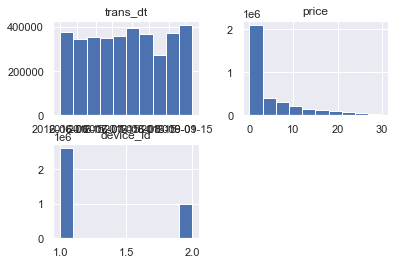

In [27]:
transaction_df.hist()

## Prepare Master Dataframe

Using the transaction data as the origin.source data, append all the possible information from the other data sources to generate a master dataframe with as many potentially meaningful columns.

In [28]:
# Note that for transactions df there are only Games for in-app
transaction_df2 = transaction_df.copy().merge(in_app_df[['parent_app_content_id', 'category_name']], how='inner', right_on='parent_app_content_id', left_on='content_id')
transaction_df2.groupby('category_name').count()

,trans_dt,content_id,acct_id,price,device_id,parent_app_content_id
category_name,,,,,,
Games,893124,893124,893124,893124,893124,893124


In [29]:
# bring in-app data to the trnsaction level

transaction_df= transaction_df.merge(in_app_df[['content_id', 'type']], how="left", on="content_id")
transaction_df["type"].fillna("consumable", inplace = True)
transaction_df['type'] = transaction_df['type'].replace(['consumable'],'one-time')
transaction_df.rename(columns={'type':'purchase_type'}, inplace=True)

# bring device data to the transaction level
transaction_df = transaction_df.merge(device_ref_df, how="left", on="device_id")

# Create app type indicator 
def app_type(row):  
    if row['price'] > 0 :
        return 'paid'
    else:
        return 'free'

transaction_df['app_type'] = transaction_df.apply(lambda row: app_type(row), axis=1)

# merge app data to the transaction level
transaction_df = transaction_df.merge(app_df[['content_id', 'category_name']], how='left', on='content_id')

# fill in-app missing categories with Games as discovered from EDA
transaction_df['category_name'] = transaction_df['category_name'].fillna('Games')

# merge account data
transaction_df = transaction_df.merge(account_df, how="left", on="acct_id")

# drop 2742 records missing account data
df = transaction_df.dropna()

In [30]:
# Check to make sure records match
assert df['acct_status'].count() + 2742 == 3607509, 'Record Count Mismatch'

In [31]:
# add potential date fields to df
df['trans_mth'] = df['trans_dt'].dt.month
df['acct_mth_yr'] = df['acct_create_dt'].dt.to_period('M')

<ipython-input-31-2e7c28c66cea>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['trans_mth'] = df['trans_dt'].dt.month
<ipython-input-31-2e7c28c66cea>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['acct_mth_yr'] = df['acct_create_dt'].dt.to_period('M')


In [32]:
df.head()

,trans_dt,content_id,acct_id,price,device_id,purchase_type,device_name,app_type,category_name,acct_create_dt,payment_type,acct_status,trans_mth,acct_mth_yr
0,2016-08-28,b6cf4f33e7455df4,220574a7a6a71afa,11.99,1,subscription,iPhone,paid,Games,2009-08-29,PMOF,old,8,2009-08
1,2016-09-16,71ac3e9c38ddbbba,8551f69a5015ea6a,1.99,2,one-time,iPad,paid,Games,2011-05-28,PMOF,old,9,2011-05
2,2016-08-15,776b851b916c33d1,7dedf309494a1966,0.99,2,one-time,iPad,paid,Games,2009-11-15,PMOF,old,8,2009-11
3,2016-06-17,7a47ca132a8dc695,7174a81c796dcf7e,1.99,2,one-time,iPad,paid,Games,2009-03-01,PMOF,old,6,2009-03
4,2016-06-13,30581219bc952dbb,35aaf59d64a677e7,11.99,2,one-time,iPad,paid,Games,2010-10-01,PMOF,old,6,2010-10


In [33]:
df.groupby('purchase_type').count()

,trans_dt,content_id,acct_id,price,device_id,device_name,app_type,category_name,acct_create_dt,payment_type,acct_status,trans_mth,acct_mth_yr
purchase_type,,,,,,,,,,,,,
one-time,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557,3413557
subscription,191210,191210,191210,191210,191210,191210,191210,191210,191210,191210,191210,191210,191210


In [34]:
df.groupby('category_name', dropna=False).count()

,trans_dt,content_id,acct_id,price,device_id,purchase_type,device_name,app_type,acct_create_dt,payment_type,acct_status,trans_mth,acct_mth_yr
category_name,,,,,,,,,,,,,
Entertainment,244257,244257,244257,244257,244257,244257,244257,244257,244257,244257,244257,244257,244257
Games,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457,2670457
Photos & Videos,347332,347332,347332,347332,347332,347332,347332,347332,347332,347332,347332,347332,347332
Social Networking,65211,65211,65211,65211,65211,65211,65211,65211,65211,65211,65211,65211,65211
Utilities,277510,277510,277510,277510,277510,277510,277510,277510,277510,277510,277510,277510,277510


In [35]:
df.groupby('acct_status', dropna=False).count()

,trans_dt,content_id,acct_id,price,device_id,purchase_type,device_name,app_type,category_name,acct_create_dt,payment_type,trans_mth,acct_mth_yr
acct_status,,,,,,,,,,,,,
current,65910,65910,65910,65910,65910,65910,65910,65910,65910,65910,65910,65910,65910
future,193398,193398,193398,193398,193398,193398,193398,193398,193398,193398,193398,193398,193398
old,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459,3345459


In [36]:
def unique_countplot(df, unique_id, attribute, bins:list =None, labels:list = None):
    """
    Plots the unique counts of values within a categorical or numerical
    attribute. Takes the unique_id attribute within the DataFrame, but assumes 
    and duplication exists within DataFrame for the id.
    """  
    fig, (axis1) = plt.subplots(1,1,figsize=(15,5))
    unique = df.groupby(["acct_id", attribute]).count().reset_index()
    
    if bins:
        unique[f"{attribute}_bins"] = pd.cut(unique[attribute], bins=bins, labels=labels, include_lowest=True)
        attribute = f"{attribute}_bins"
        
    
    return sns.countplot(x=attribute, data=unique, palette="husl", ax=axis1)




<AxesSubplot:xlabel='acct_status', ylabel='count'>

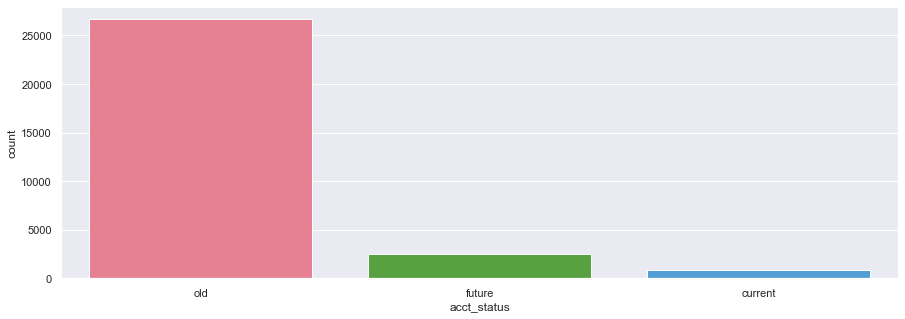

In [37]:
unique_countplot(df, unique_id='acct_id', attribute='acct_status')

<AxesSubplot:xlabel='category_name', ylabel='count'>

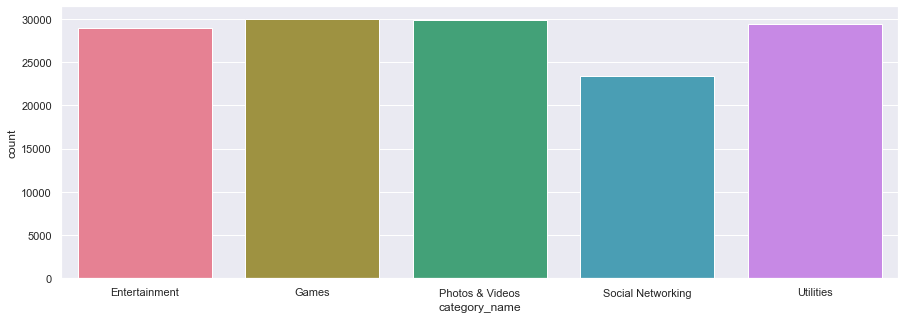

In [38]:
unique_countplot(df, unique_id='content_id', attribute='category_name')


<AxesSubplot:xlabel='device_name', ylabel='count'>

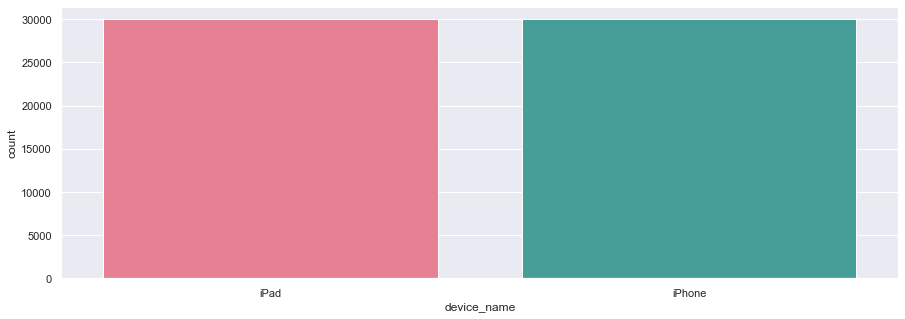

In [39]:
unique_countplot(df, unique_id='acct_id', attribute="device_name")


# Segmentation Analysis

## App Segmentation

In [40]:
def compare_by_category(_df, cat_col, metric, how):
    """
    Generate a plot to compare any of the specifed metrics for the category col of interest
    """
    # rename the metrics based on the aggregation method
    metric_col_dict = {
        "total_revenue": f"{how}_revenue_per_app",
        "total_downloads": f"{how}_downloads_per_app",
        "weekly_revenue": f"{how}_revenue_per_week_per_app",
        "num_weekly_downloads": f"{how}_downloads_per_week_per_app",           
        "total_users": f"{how}_users_per_app"
    }
    
    fig, (axis1) = plt.subplots(1,1,figsize=(15,5))
    
    # aggregate the metrics based on selected aggregtion method
    category_analysis = _df.groupby([cat_col]).agg({
        "total_revenue": how,
        "total_downloads": how,
        "total_users": how, 
        "weekly_revenue": how,
        "num_weekly_downloads": how
    }).rename(columns=metric_col_dict).reset_index()
    
    return sns.barplot(x=cat_col, y=metric_col_dict[metric], data=category_analysis)

In [41]:
# use app dataframe as source data
app_segmentation = app_ref_df.copy()

# Calculate app stats on the transaction level
transaction_level_app_summary= df.groupby([
    'category_name'
    , 'trans_mth'
    , 'device_name'
]).agg(total_users = ('acct_id','nunique') # num unique users per genre
       , total_downloads=('trans_dt','count') # num of transactions per genre
       , total_revenue = ('price','sum') ).reset_index()

transaction_level_app_summary['trans_per_acct'] = transaction_level_app_summary['total_downloads']/ transaction_level_app_summary['total_users']
transaction_level_app_summary['rev_per_acct'] = transaction_level_app_summary['total_revenue'] / transaction_level_app_summary['total_users']

# summarize on the stats on the app level
app_transaction_summary = df.groupby([
    'content_id'
]).agg(total_users = ('acct_id','nunique')
      , total_downloads=('trans_dt','count')
      , total_revenue = ('price','sum')).reset_index()

app_segmentation.head()



,app_name,content_id,category_id,device_id,category_name,device_name
0,half-slouched having,22dfac9721b899cb,Y-8,3,Photos & Videos,Both
1,lift whale-ships,7c645810cd7f166e,M-7,3,Utilities,Both
2,mightily community,c495bcb878faffaa,Y-8,2,Photos & Videos,iPad
3,session: too--shall,4e683dcd461cdd22,Y-8,1,Photos & Videos,iPhone
4,That Zoology,6473dd29a2badbf1,Y-8,3,Photos & Videos,Both


In [42]:
# this is on the transaction level and needs to be moved to app level. 
app_transaction_summary.head()

,content_id,total_users,total_downloads,total_revenue
0,002f3775d84a816a,894,922,8288.78
1,0052e4fbb5a6c259,680,707,699.93
2,0090cc76db298a8f,671,700,12593.00
3,00940db10d26b770,660,697,14630.03
4,00bc137c2cdb50ee,653,673,9415.27


In [43]:
transaction_level_app_summary.head()

,category_name,trans_mth,device_name,total_users,total_downloads,total_revenue,trans_per_acct,rev_per_acct
0,Entertainment,6,iPad,12791,21049,6665.35,1.645610,0.521097
1,Entertainment,6,iPhone,20328,45422,28851.61,2.234455,1.419304
2,Entertainment,7,iPad,13080,21681,7200.32,1.657569,0.550483
3,Entertainment,7,iPhone,20787,47655,30501.34,2.292539,1.467328
4,Entertainment,8,iPad,12283,19607,6149.55,1.596271,0.500655


In [44]:
# Generate a weekly level dataframe by app

weekly_transactions_by_app = df.copy().reset_index().groupby([
    'content_id', 
    pd.Grouper(key = 'trans_dt', freq='W-Wed')
]).agg({
    'price': 'sum',
    'device_id': 'count'
}).rename(columns={
    'price': 'weekly_revenue',
    'device_id': 'num_weekly_downloads'
})

weekly_transactions_by_app.head()

weekly_revenue  num_weekly_downloads
content_id       trans_dt                                        
002f3775d84a816a 2016-06-01           80.91                     9
                 2016-06-08          494.45                    55
                 2016-06-15          449.50                    50
                 2016-06-22          485.46                    54
                 2016-06-29          575.36                    64

In [45]:
# calculate averges for weekly fields
weekly_app_summary = weekly_transactions_by_app.reset_index().groupby('content_id').mean().reset_index()

# add weekly data to app_segementation dataframe
app_segmentation = app_segmentation.merge(weekly_app_summary, on='content_id')
app_segmentation = app_segmentation.merge(app_transaction_summary, on='content_id')


In [46]:
app_segmentation.head()

,app_name,content_id,category_id,device_id,category_name,device_name,weekly_revenue,num_weekly_downloads,total_users,total_downloads,total_revenue
0,pro- chick,a287d248d66f915b,Z-1,1,Games,iPhone,0.0,312.882353,4472,5319,0.0
1,expansive utter,947d085ce02c9b0e,Z-1,3,Games,Both,0.0,306.823529,4448,5216,0.0
2,noting Dry,3e8d4ceb1d7294c4,M-7,3,Utilities,Both,0.0,310.411765,4446,5277,0.0
3,bunk bringing,019008a4dabf7c93,Z-1,3,Games,Both,0.0,301.117647,4332,5119,0.0
4,unobservant sorts,04d7461141bb1485,Z-1,3,Games,Both,0.0,311.294118,4448,5292,0.0


### Comparing App Categories 

<AxesSubplot:xlabel='category_name', ylabel='sum_revenue_per_app'>

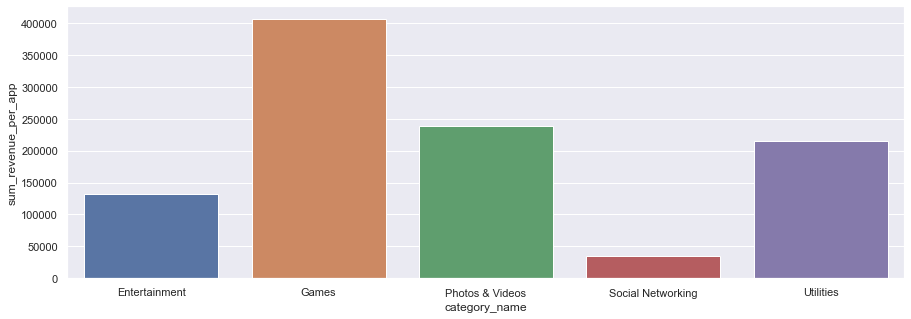

In [47]:
compare_by_category(app_segmentation, 'category_name', 'total_revenue', how='sum')

as expected, Game apps generate the most total revenue. 

<AxesSubplot:xlabel='category_name', ylabel='mean_revenue_per_app'>

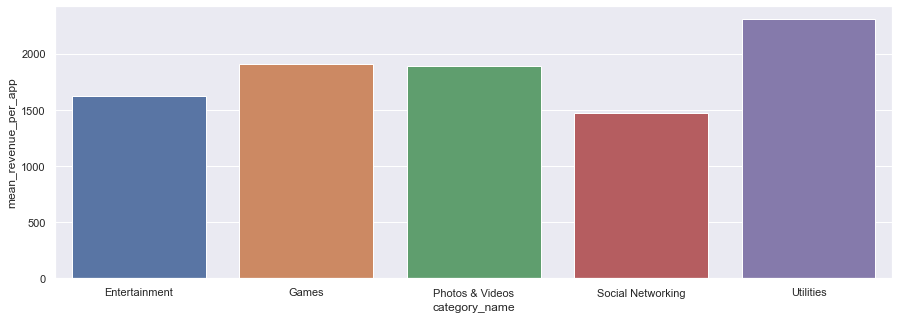

In [48]:
compare_by_category(app_segmentation, 'category_name', 'total_revenue', how='mean')

However, looking on average, we see that Utility apps actually have higher average revenue per app than Gaming apps. 

This can likely be explained given the fact that Game related download/purchases are likely to be a lower costs but have more occurances. Thus, increasing the total revenue, but lowering the average revenue.

<AxesSubplot:xlabel='category_name', ylabel='sum_downloads_per_app'>

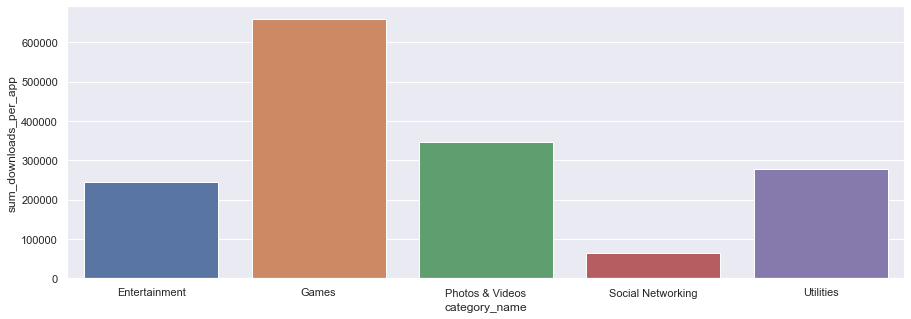

In [49]:
compare_by_category(app_segmentation, 'category_name', 'total_downloads', how='sum')

Examining the categories and distribution of total number of downloads per app grouped by category, we see that Game apps have the highest number of downloads - which matches the information we have seen thus far. 

<AxesSubplot:xlabel='category_name', ylabel='mean_downloads_per_app'>

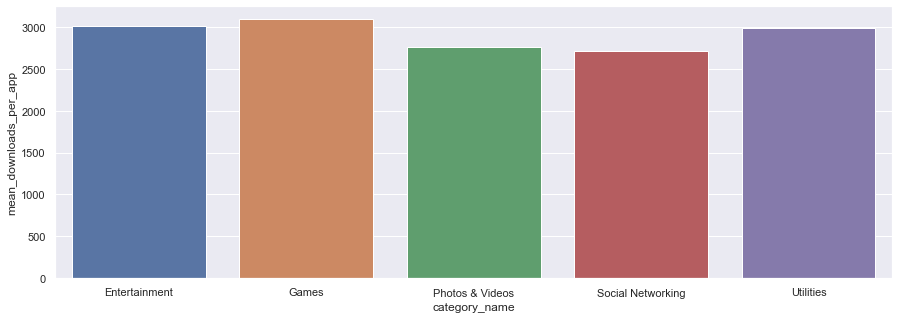

In [50]:
compare_by_category(app_segmentation, 'category_name', 'total_downloads', how='mean')

Looking at the average download per apps by category, we see that the skewed distribution is much less. This suggests that all categories of apps on average have between 2700-3100 downloads.

<AxesSubplot:xlabel='category_name', ylabel='mean_downloads_per_week_per_app'>

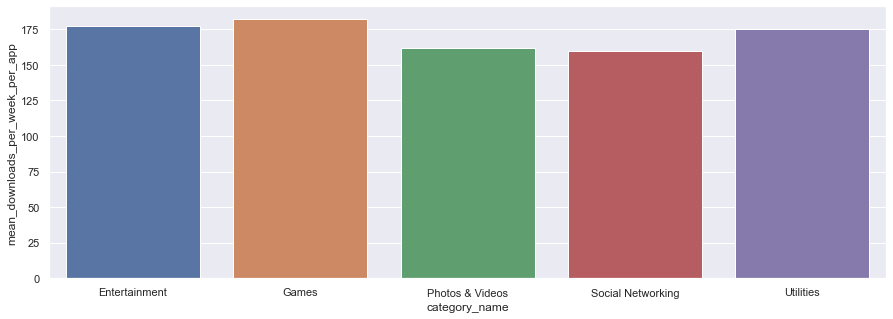

In [51]:
compare_by_category(app_segmentation, 'category_name', 'num_weekly_downloads', how='mean')

<AxesSubplot:xlabel='category_name', ylabel='sum_revenue_per_week_per_app'>

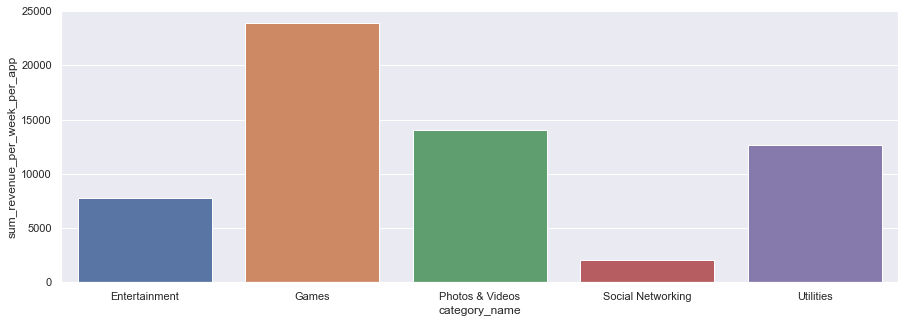

In [52]:
compare_by_category(app_segmentation, 'category_name', 'weekly_revenue', how='sum')

<AxesSubplot:xlabel='category_name', ylabel='sum_users_per_app'>

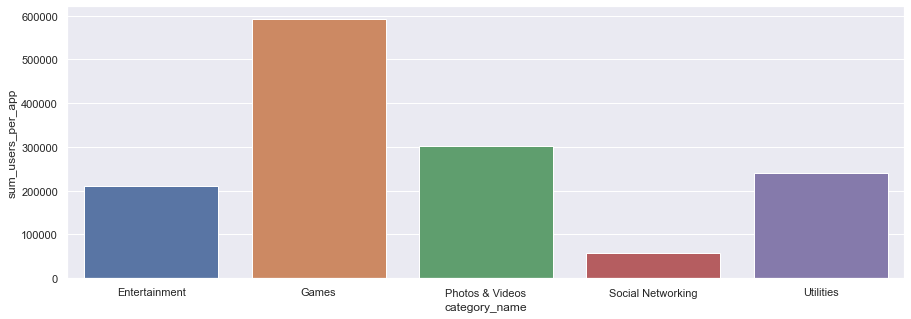

In [53]:
compare_by_category(app_segmentation, 'category_name', 'total_users', how='sum')

<AxesSubplot:xlabel='device_name', ylabel='sum_downloads_per_app'>

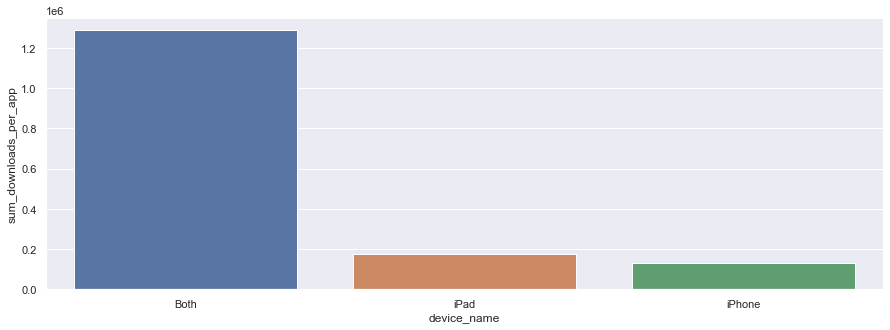

In [54]:
compare_by_category(app_segmentation, 'device_name', 'total_downloads', how='sum')

### Comparing Transactions

<AxesSubplot:xlabel='device_name', ylabel='rev_per_acct'>

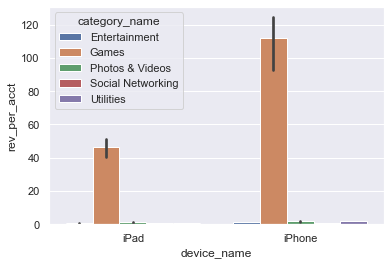

In [55]:
sns.barplot(x="device_name", y="rev_per_acct", hue="category_name", data=transaction_level_app_summary)

When trying to look at the distribution of revenue per account, we see that gaming has the highest revenue per account across all potential cateogires, for both devices iPad and iPhone.

<AxesSubplot:xlabel='device_name', ylabel='rev_per_acct'>

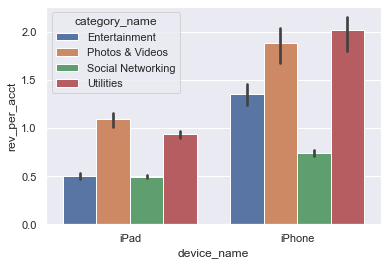

In [56]:
sns.barplot(x="device_name", y="rev_per_acct", hue="category_name", data=transaction_level_app_summary[transaction_level_app_summary['category_name'] != 'Games'])

Removing the gaming category, we see that the distribution of revenue per account by category differs for iPads and iPhones. Photo & video iPad compatiable apps generate the most revenue per account vs. the Utility apps for iphone users.

## User Segmentation

In [57]:
def compare_by_cohort(_df, cohort_col, metric, how):
    """
    Generate a plot that compares any of the 4 specified metrics for the cohort of interest
    """
    metric_col_dict = {
        "total_revenue": f"{how}_revenue_per_user",
        "total_downloads": f"{how}_downloads_per_user",
        "weekly_revenue": f"{how}_revenue_per_week_per_user",
        "num_weekly_downloads": f"{how}_downloads_per_week_per_user"          
        
    }
    
    cohort_analysis = _df.groupby([cohort_col]).agg({
        "total_revenue": how,
        "total_downloads": how,
        "weekly_revenue": how,
        "num_weekly_downloads": how
    }).rename(columns=metric_col_dict).reset_index()
    
    return sns.barplot(x=cohort_col, y=metric_col_dict[metric], data=cohort_analysis)

In [58]:
# user segmentation is on the account level
user_segmentation = account_df.copy()

# create cohort column based on acct create year
user_segmentation["cohort"] = user_segmentation["acct_create_dt"].dt.year


In [59]:
user_segmentation.groupby(["cohort"]).size()

cohort
2007     4214
2008     9709
2009     9898
2010    10128
2011    10056
2012    10131
2013     9961
2014     9955
2015    10180
2016    10054
2017     5714
dtype: int64

In [60]:
# Generate weekly metrics per user
weekly_transactions_by_user = transaction_df.copy().reset_index().groupby([
    'acct_id', 
    pd.Grouper(key = 'trans_dt', freq='W-Wed') # weeks from Wed to Wed
]).agg({
    'price': 'sum',
    'device_id': 'count'
}).rename(columns={
    'price': 'weekly_revenue',
    'device_id': 'num_weekly_downloads'
})

weekly_transactions_by_user.head()


weekly_revenue  num_weekly_downloads
acct_id          trans_dt                                        
00028709c8d435ff 2016-06-08             0.0                     4
                 2016-06-15             0.0                     3
                 2016-06-22             0.0                     2
                 2016-06-29             0.0                     8
                 2016-07-06             0.0                     5

In [61]:
weekly_user_summary = weekly_transactions_by_user.reset_index().groupby('acct_id').mean()

### Defining a Free vs. Paying User

In [64]:
def paying_user_agg_function(x):
    """
    Return a flag for when the revenue (price) is greater than 0
    """
    if x.empty:
        return None 
    else: 
        if x[x>0].size > 0:
            return True
        else:
            return False

# Summarize user transactions
user_transaction_summary = transaction_df.reset_index().merge(app_df, on='content_id').groupby(["acct_id"]).agg({
    "price": [np.sum, paying_user_agg_function],
    "trans_dt": 'count',
}).rename(columns={
    "price": "revenue",
    "trans_dt": "downloads"
})

user_transaction_summary.head()

revenue                          downloads
                     sum paying_user_agg_function     count
acct_id                                                    
00028709c8d435ff    0.00                    False        71
0005a4d77127fde7   57.83                     True        26
0005c296f2605c08   45.81                     True        27
00082ad3dc50a70d    0.00                    False        76
00085ff73786df4d   60.86                     True        23

In [65]:
# user_transaction_summary.columns.get_level_values(0)
user_transaction_summary.columns = ['_'.join(col) for col in user_transaction_summary.columns.values]
user_transaction_summary.rename(columns={
    "revenue_sum": "total_revenue",
    "revenue_paying_user_agg_function": "paying_user",
    "downloads_count": 'total_downloads'
}, inplace=True)
user_transaction_summary.head()

,total_revenue,paying_user,total_downloads
acct_id,,,
00028709c8d435ff,0.00,False,71
0005a4d77127fde7,57.83,True,26
0005c296f2605c08,45.81,True,27
00082ad3dc50a70d,0.00,False,76
00085ff73786df4d,60.86,True,23


<AxesSubplot:>

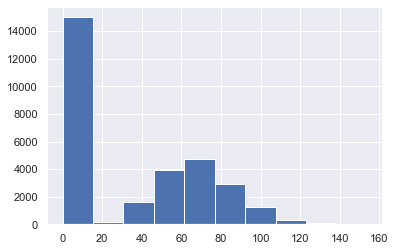

In [66]:
user_transaction_summary["total_revenue"].hist()

<AxesSubplot:>

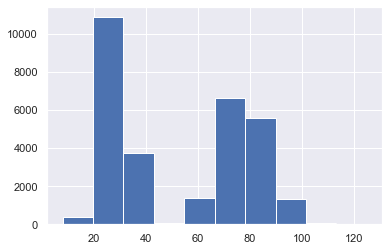

In [67]:
user_transaction_summary["total_downloads"].hist()

we have two types of users. Ones who download alot (70-90) and ones who only download (20-30) over 3month span (transaction lifetime data). Let's define an active user as users who have downloaded more than the average number of downloads over a 3 month span

In [68]:
active_user_download_threshold = round(user_transaction_summary["total_downloads"].mean())
print(f"Average number of downloads { active_user_download_threshold }")

Average number of downloads 53


This number seems to be skewed high. Based on the distribution, since there is an overwhelmingly large , a more reasonable threshold would be around having an average number of 10 transactions to define an acive user 

I assumed that active users would account for the majority of revenue, but the overwhelingly large free users who don't pay, and download a lot skew the 'active'distribution (to the right) and create two distinct groups (paying vs non paying). this led to active users not generating revenue which is counter intuitive to our hypothesis. From here, I lowered the threshold to avg of 15 downloads and then looked into more detailed breakdowns - pay vs non pay, and quality (active & paying). 

### Defining Active User

While active users may have 15 transactions on averge, a better "higher quality" customer is someone who is a paying customer, and is an active customer. Therefore Quality Users can be defined as paying AND active. 

In [69]:
def is_active_user(num_downloads):
    """
    return a flag if the number of dowloads is greater than 15
    """
    if num_downloads >= 15:
        return True
    else:
        return False

In [70]:

# Merge user transaction summarized data with account data
user_segmentation = user_segmentation.merge(user_transaction_summary, on='acct_id')
user_segmentation["is_active"] = user_segmentation['total_downloads'].apply(is_active_user)


user_segmentation.head()

,acct_id,acct_create_dt,payment_type,acct_status,cohort,total_revenue,paying_user,total_downloads,is_active
0,9b6d6fbf76504d85,2008-11-06,PMOF,old,2008,61.81,True,28,True
1,343255370828b380,2012-01-03,PMOF,old,2012,82.74,True,33,True
2,0fcabb83f967764d,2010-06-29,PMOF,old,2010,80.79,True,28,True
3,35e8a19533d53afb,2008-11-28,PMOF,old,2008,112.68,True,40,True
4,c413bad6da754865,2009-07-29,PMOF,old,2009,82.79,True,29,True


## Defining Quality User

In [71]:
# Quality user is when they are both active and paying
user_segmentation["quality_user"] = user_segmentation["is_active"] & user_segmentation["paying_user"]
user_segmentation = user_segmentation.merge(weekly_user_summary, on='acct_id')

In [72]:
# previously with 53 threshold there was no quality users.
user_segmentation[(user_segmentation["is_active"] == True) & (user_segmentation["paying_user"] == True)]

,acct_id,acct_create_dt,payment_type,acct_status,cohort,total_revenue,paying_user,total_downloads,is_active,quality_user,weekly_revenue,num_weekly_downloads
0,9b6d6fbf76504d85,2008-11-06,PMOF,old,2008,61.81,True,28,True,True,80.558824,9.352941
1,343255370828b380,2012-01-03,PMOF,old,2012,82.74,True,33,True,True,63.290625,8.875000
2,0fcabb83f967764d,2010-06-29,PMOF,old,2010,80.79,True,28,True,True,59.090588,9.000000
3,35e8a19533d53afb,2008-11-28,PMOF,old,2008,112.68,True,40,True,True,68.148235,9.176471
4,c413bad6da754865,2009-07-29,PMOF,old,2009,82.79,True,29,True,True,64.350000,9.250000
...,...,...,...,...,...,...,...,...,...,...,...,...
14977,d0a58b2a421d41e7,2010-02-10,PMOF,old,2010,65.84,True,27,True,True,62.572941,8.058824
14978,16c8932a3a76141f,2011-03-10,PMOF,old,2011,81.79,True,30,True,True,78.972353,9.176471
14979,32fd9f7fb6428211,2008-11-19,PMOF,old,2008,78.79,True,27,True,True,60.920000,8.352941
14980,4e0a559643112c8a,2012-05-24,PMOF,old,2012,45.85,True,23,True,True,70.264118,9.352941


### Comparing Active Users

### Old Definition > Avg Downloads (53) 

In [538]:
# def is_active_user(num_downloads):
#     if num_downloads >= 53:
#         return True
#     else:
#         return False

<AxesSubplot:xlabel='is_active', ylabel='mean_revenue_per_user'>

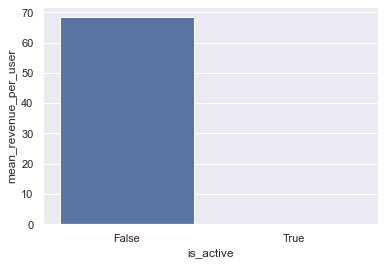

In [556]:
compare_by_cohort(user_segmentation, "is_active", "total_revenue", how='mean')

<AxesSubplot:xlabel='is_active', ylabel='mean_downloads_per_user'>

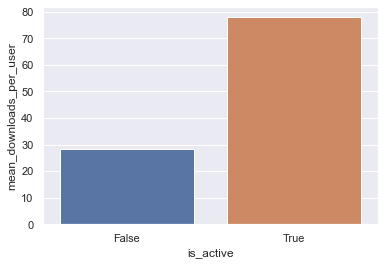

In [557]:
compare_by_cohort(user_segmentation, "is_active", "total_downloads", how='mean')

<AxesSubplot:xlabel='is_active', ylabel='mean_revenue_per_week_per_user'>

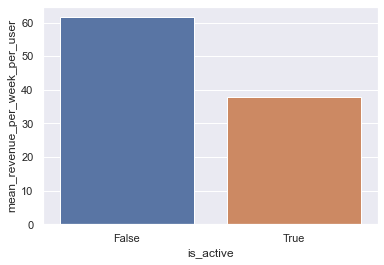

In [510]:
compare_by_cohort(user_segmentation, "is_active", "weekly_revenue", how='mean')

### New Definition > 15 Downloads

In [512]:
# def is_active_user(num_downloads):
#     if num_downloads >= 15:
#         return True
#     else:
#         return False

<AxesSubplot:xlabel='is_active', ylabel='mean_revenue_per_user'>

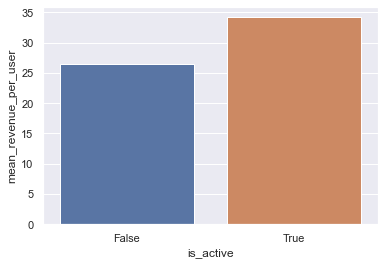

In [73]:
compare_by_cohort(user_segmentation, "is_active", "total_revenue", how='mean')

<AxesSubplot:xlabel='is_active', ylabel='mean_downloads_per_user'>

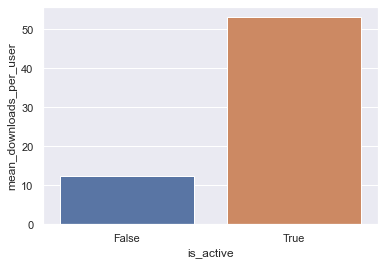

In [74]:
compare_by_cohort(user_segmentation, "is_active", "total_downloads", how='mean')

<AxesSubplot:xlabel='is_active', ylabel='mean_revenue_per_week_per_user'>

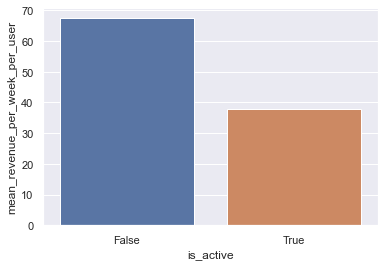

In [75]:
compare_by_cohort(user_segmentation, "is_active", "weekly_revenue", how='mean')

<AxesSubplot:xlabel='is_active', ylabel='mean_downloads_per_week_per_user'>

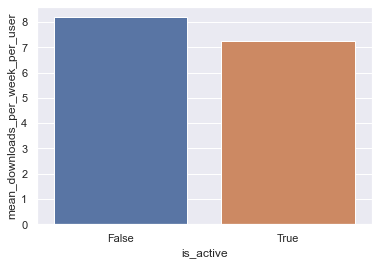

In [76]:
compare_by_cohort(user_segmentation, "is_active", "num_weekly_downloads", how='mean')

### Comparing Free vs. Paying Users

<AxesSubplot:xlabel='paying_user', ylabel='mean_revenue_per_user'>

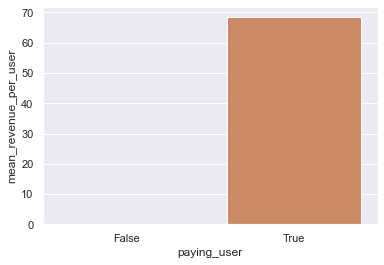

In [77]:
compare_by_cohort(user_segmentation, "paying_user", "total_revenue", how='mean')

<AxesSubplot:xlabel='paying_user', ylabel='mean_downloads_per_user'>

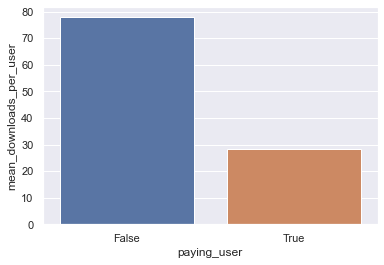

In [78]:
compare_by_cohort(user_segmentation, "paying_user", "total_downloads", how='mean')

<AxesSubplot:xlabel='paying_user', ylabel='mean_revenue_per_week_per_user'>

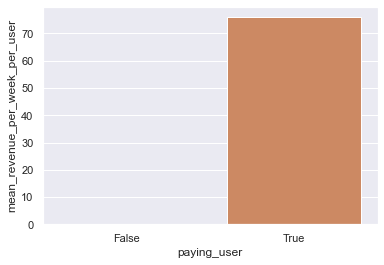

In [79]:
compare_by_cohort(user_segmentation, "paying_user", "weekly_revenue", how='mean')

<AxesSubplot:xlabel='paying_user', ylabel='mean_downloads_per_week_per_user'>

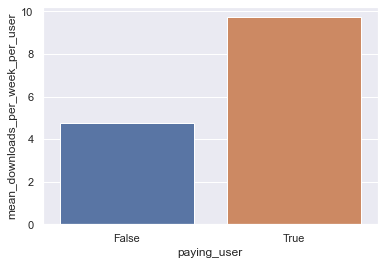

In [80]:
compare_by_cohort(user_segmentation, "paying_user", "num_weekly_downloads", how='mean')

### Comparing Quality Users

<AxesSubplot:xlabel='quality_user', ylabel='mean_revenue_per_user'>

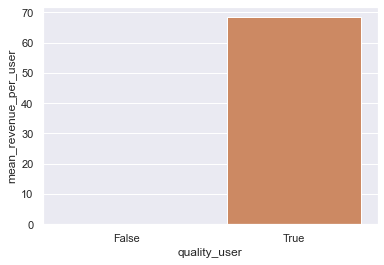

In [81]:
compare_by_cohort(user_segmentation, "quality_user", "total_revenue", how='mean')

<AxesSubplot:xlabel='quality_user', ylabel='mean_downloads_per_user'>

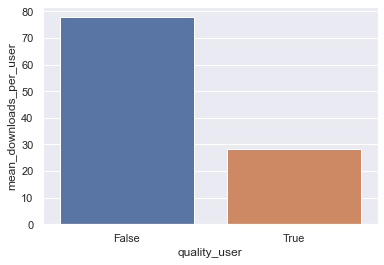

In [82]:
compare_by_cohort(user_segmentation, "quality_user", "total_downloads", how='mean')

<AxesSubplot:xlabel='quality_user', ylabel='mean_revenue_per_week_per_user'>

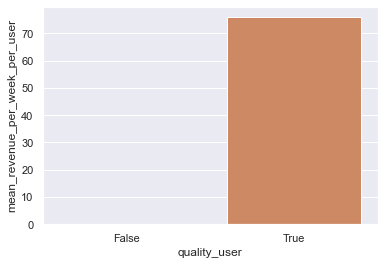

In [83]:
compare_by_cohort(user_segmentation, "quality_user", "weekly_revenue", how='mean')

<AxesSubplot:xlabel='quality_user', ylabel='mean_downloads_per_week_per_user'>

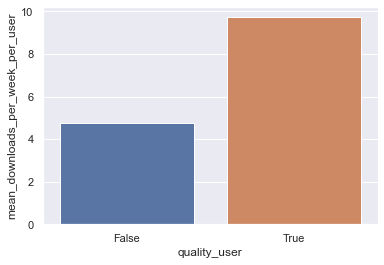

In [84]:
compare_by_cohort(user_segmentation, "quality_user", "num_weekly_downloads", how='mean')

### Comparing Account Created Cohorts

<AxesSubplot:xlabel='cohort', ylabel='mean_revenue_per_user'>

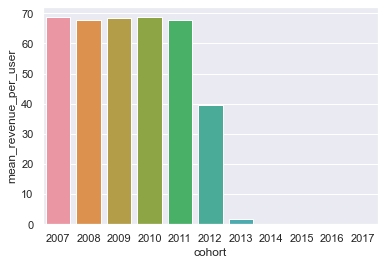

In [85]:
compare_by_cohort(user_segmentation, "cohort", "total_revenue", how='mean')

<AxesSubplot:xlabel='cohort', ylabel='mean_downloads_per_user'>

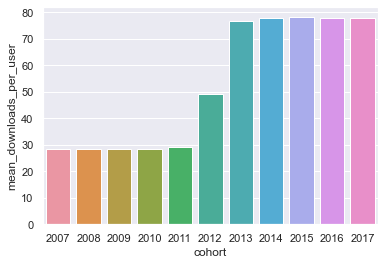

In [86]:
compare_by_cohort(user_segmentation, "cohort", "total_downloads", how='mean')

<AxesSubplot:xlabel='cohort', ylabel='mean_revenue_per_week_per_user'>

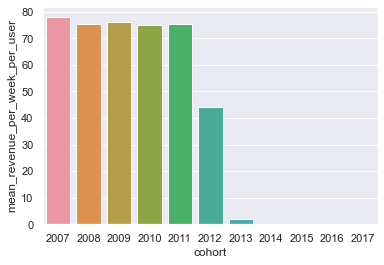

In [87]:
compare_by_cohort(user_segmentation, "cohort", "weekly_revenue", how='mean')

<AxesSubplot:xlabel='cohort', ylabel='mean_downloads_per_week_per_user'>

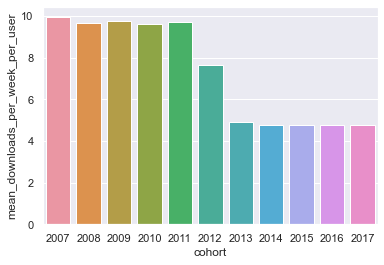

In [88]:
compare_by_cohort(user_segmentation, "cohort", "num_weekly_downloads", how='mean')

<AxesSubplot:>

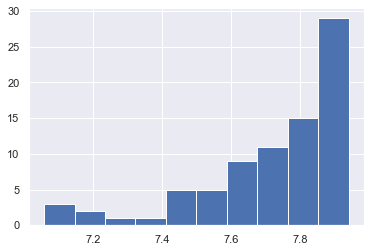

In [89]:
user_segmentation[(user_segmentation["cohort"] == 2007) & (user_segmentation["num_weekly_downloads"] < 8) ]["num_weekly_downloads"].hist()

# K Means Clustering User Segmentation

Change categorical fields into counts and percentge composition fields as a numeric representation for clustering.

* % transactions by app category
* % transactions subscription vs on-time
* % transactions free vs. paid

In [110]:
# % of transactions per user by category 
df.groupby(['acct_id','category_name']).agg({
    'trans_dt': 'count'
})



trans_dt
acct_id          category_name              
00028709c8d435ff Entertainment            10
                 Games                    27
                 Photos & Videos          19
                 Social Networking         1
                 Utilities                14
...                                      ...
ffffa8b018fa6ffd Entertainment            16
                 Games                    24
                 Photos & Videos          23
                 Social Networking         4
                 Utilities                12

[141578 rows x 1 columns]

In [111]:
# group by acct and category, and pivot data from deep to wide 

user_category_trans = df.groupby(['acct_id','category_name'])\
                    .agg({'trans_dt': 'count'}).reset_index()\
                    .pivot(index='acct_id', columns='category_name', values='trans_dt')\
                    .fillna(0)

user_category_trans.rename(columns={'Entertainment':'ent_trans'
                                     ,'Games': 'game_trans'
                                     ,'Photos & Videos':'photo_trans'
                                     ,'Social Networking': 'social_trans'
                                     , 'Utilities': 'util_trans' }, inplace=True)


# Calculate the total number of transactions for each user
user_category_trans['total_trans'] = user_category_trans['ent_trans'] + user_category_trans['game_trans']\
                                + user_category_trans['photo_trans'] + user_category_trans['social_trans']\
                                + user_category_trans['util_trans']

# Create % composition fields by dividing field counts by total count
user_category_trans['pct_ent_trans'] = round(user_category_trans['ent_trans'] / user_category_trans['total_trans'],4) *100
user_category_trans['pct_game_trans'] = round(user_category_trans['game_trans'] / user_category_trans['total_trans'],4) *100
user_category_trans['pct_photo_trans'] = round(user_category_trans['photo_trans'] / user_category_trans['total_trans'],4) *100
user_category_trans['pct_social_trans'] = round(user_category_trans['social_trans'] / user_category_trans['total_trans'],4) *100
user_category_trans['pct_util_trans'] = round(user_category_trans['util_trans'] / user_category_trans['total_trans'],4) *100

user_category_trans.head()


category_name,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,pct_photo_trans,pct_social_trans,pct_util_trans
acct_id,,,,,,,,,,,
00028709c8d435ff,10.0,27.0,19.0,1.0,14.0,71.0,14.08,38.03,26.76,1.41,19.72
0005a4d77127fde7,6.0,130.0,3.0,0.0,1.0,140.0,4.29,92.86,2.14,0.00,0.71
0005c296f2605c08,4.0,143.0,4.0,1.0,1.0,153.0,2.61,93.46,2.61,0.65,0.65
00082ad3dc50a70d,15.0,30.0,17.0,3.0,11.0,76.0,19.74,39.47,22.37,3.95,14.47
00085ff73786df4d,3.0,149.0,2.0,2.0,2.0,158.0,1.90,94.30,1.27,1.27,1.27


In [112]:
# % device type breakdown of transaction 
df.groupby(['acct_id','device_name']).agg({
    'trans_dt': 'count'
})



trans_dt
acct_id          device_name          
00028709c8d435ff iPad               23
                 iPhone             48
0005a4d77127fde7 iPad               41
                 iPhone             99
0005c296f2605c08 iPad               45
...                                ...
fffceef017abbe30 iPhone             47
fffed4fe9472fcb5 iPad               44
                 iPhone             97
ffffa8b018fa6ffd iPad               19
                 iPhone             60

[59950 rows x 1 columns]

In [113]:
# group by acct and device, and pivot data from deep to wide 

user_device_trans = df.groupby(['acct_id','device_name'])\
                    .agg({'trans_dt': 'count'}).reset_index()\
                    .pivot(index='acct_id', columns='device_name', values='trans_dt')\
                    .fillna(0)

user_device_trans.rename(columns={'iPhone':'iphone_trans','iPad': 'ipad_trans' }, inplace=True)


user_device_trans['total_trans'] = user_device_trans['iphone_trans'] + user_device_trans['ipad_trans']

user_device_trans['pct_iphone_trans'] = round(user_device_trans['iphone_trans'] / user_device_trans['total_trans'],4) *100
user_device_trans['pct_ipad_trans'] = round(user_device_trans['ipad_trans'] / user_device_trans['total_trans'],4) *100

user_device_trans.head()


device_name,ipad_trans,iphone_trans,total_trans,pct_iphone_trans,pct_ipad_trans
acct_id,,,,,
00028709c8d435ff,23,48,71,67.61,32.39
0005a4d77127fde7,41,99,140,70.71,29.29
0005c296f2605c08,45,108,153,70.59,29.41
00082ad3dc50a70d,19,57,76,75.00,25.00
00085ff73786df4d,45,113,158,71.52,28.48


In [114]:
# % purchase type breakdown of transaction 
df.groupby(['acct_id','purchase_type']).agg({
    'trans_dt': 'count'
})



trans_dt
acct_id          purchase_type          
00028709c8d435ff one-time             71
0005a4d77127fde7 one-time            127
                 subscription         13
0005c296f2605c08 one-time            142
                 subscription         11
...                                  ...
fffb6b3ecb46225b one-time             70
fffceef017abbe30 one-time             70
fffed4fe9472fcb5 one-time            126
                 subscription         15
ffffa8b018fa6ffd one-time             79

[44957 rows x 1 columns]

In [115]:
# group by acct and purchase_type, and pivot data from deep to wide 

user_purchase_type_trans = df.groupby(['acct_id','purchase_type'])\
                    .agg({'trans_dt': 'count'}).reset_index()\
                    .pivot(index='acct_id', columns='purchase_type', values='trans_dt')\
                    .fillna(0)

user_purchase_type_trans.rename(columns={'one-time':'onetime_trans','subscription': 'subscription_trans' }, inplace=True)


user_purchase_type_trans['total_trans'] = user_purchase_type_trans['onetime_trans'] + user_purchase_type_trans['subscription_trans']

user_purchase_type_trans['pct_onetime_trans'] = round(user_purchase_type_trans['onetime_trans'] / user_purchase_type_trans['total_trans'],4) *100
user_purchase_type_trans['pct_subscription_trans'] = round(user_purchase_type_trans['subscription_trans'] / user_purchase_type_trans['total_trans'],4) *100

user_purchase_type_trans.head()


purchase_type,onetime_trans,subscription_trans,total_trans,pct_onetime_trans,pct_subscription_trans
acct_id,,,,,
00028709c8d435ff,71.0,0.0,71.0,100.00,0.00
0005a4d77127fde7,127.0,13.0,140.0,90.71,9.29
0005c296f2605c08,142.0,11.0,153.0,92.81,7.19
00082ad3dc50a70d,76.0,0.0,76.0,100.00,0.00
00085ff73786df4d,152.0,6.0,158.0,96.20,3.80


In [116]:
# % category breakdown of transaction 
df.groupby(['acct_id','app_type']).agg({
    'trans_dt': 'count'
})



trans_dt
acct_id          app_type          
00028709c8d435ff free            71
0005a4d77127fde7 free             9
                 paid           131
0005c296f2605c08 free             8
                 paid           145
...                             ...
fffb6b3ecb46225b free            70
fffceef017abbe30 free            70
fffed4fe9472fcb5 free            11
                 paid           130
ffffa8b018fa6ffd free            79

[44957 rows x 1 columns]

In [117]:
# group by acct and app type, and pivot data from deep to wide 
user_app_type_trans = df.groupby(['acct_id','app_type'])\
                    .agg({'trans_dt': 'count'}).reset_index()\
                    .pivot(index='acct_id', columns='app_type', values='trans_dt')\
                    .fillna(0)

user_app_type_trans.rename(columns={'free':'free_trans','paid': 'paid_trans' }, inplace=True)


user_app_type_trans['total_trans'] = user_app_type_trans['free_trans'] + user_app_type_trans['paid_trans']

user_app_type_trans['pct_free_trans'] = round(user_app_type_trans['free_trans'] / user_app_type_trans['total_trans'],4) *100
user_app_type_trans['pct_paid_trans'] = round(user_app_type_trans['paid_trans'] / user_app_type_trans['total_trans'],4) *100

user_app_type_trans.head()


app_type,free_trans,paid_trans,total_trans,pct_free_trans,pct_paid_trans
acct_id,,,,,
00028709c8d435ff,71.0,0.0,71.0,100.00,0.00
0005a4d77127fde7,9.0,131.0,140.0,6.43,93.57
0005c296f2605c08,8.0,145.0,153.0,5.23,94.77
00082ad3dc50a70d,76.0,0.0,76.0,100.00,0.00
00085ff73786df4d,9.0,149.0,158.0,5.70,94.30


In [120]:
# Source date for user clustering is account dataframe
user_cluster_segmentation = None
user_cluster_segmentation = account_df.copy()

category_fields = ['ent_trans','game_trans','photo_trans','social_trans','util_trans'
                   ,'pct_ent_trans','pct_game_trans','pct_photo_trans','pct_social_trans','pct_util_trans']

# merge category_trans
user_cluster_segmentation = user_cluster_segmentation.merge(user_category_trans, on='acct_id', how='left')

# merge device_type_trans
device_type_fields = ['iphone_trans', 'ipad_trans', 'pct_iphone_trans', 'pct_ipad_trans']
user_cluster_segmentation = user_cluster_segmentation.merge(user_device_trans[device_type_fields], on='acct_id', how='left')

# merge purchase_type_trans
purchase_type_fields = ['onetime_trans', 'subscription_trans', 'pct_onetime_trans', 'pct_subscription_trans']
user_cluster_segmentation = user_cluster_segmentation.merge(user_purchase_type_trans[purchase_type_fields], on='acct_id', how='left')

# merge app_type_trans
app_type_fields = ['free_trans', 'paid_trans', 'pct_free_trans', 'pct_paid_trans']
user_cluster_segmentation = user_cluster_segmentation.merge(user_app_type_trans[app_type_fields], on='acct_id', how='left')

# change PMOF to a numeric ind
user_cluster_segmentation.rename(columns={"payment_type": "PMOF_ind"}, inplace=True)
user_cluster_segmentation['PMOF_ind'] = user_cluster_segmentation['PMOF_ind'].replace({'PMOF':1, 'Free only':0}).astype(float)

# calculate the days acct tenure: moment in time max(trans_dt) - acct_create_dt
user_cluster_segmentation['acct_tenure'] = (dt.datetime.strptime('2016-09-21', '%Y-%m-%d') - user_cluster_segmentation['acct_create_dt']).dt.days


user_cluster_segmentation = user_cluster_segmentation.copy().dropna().drop(columns=['acct_create_dt', 'acct_status'])

In [121]:
user_cluster_segmentation.head()
# user_cluster_segmentation.loc[~(user_cluster_segmentation==0).all(axis=1)]

,acct_id,PMOF_ind,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,...,pct_ipad_trans,onetime_trans,subscription_trans,pct_onetime_trans,pct_subscription_trans,free_trans,paid_trans,pct_free_trans,pct_paid_trans,acct_tenure
2,9b6d6fbf76504d85,1.0,5.0,148.0,6.0,0.0,0.0,159.0,3.14,93.08,...,25.79,147.0,12.0,92.45,7.55,9.0,150.0,5.66,94.34,2876
3,343255370828b380,1.0,4.0,127.0,6.0,2.0,3.0,142.0,2.82,89.44,...,28.87,137.0,5.0,96.48,3.52,7.0,135.0,4.93,95.07,1723
6,0fcabb83f967764d,1.0,2.0,143.0,2.0,1.0,5.0,153.0,1.31,93.46,...,31.37,141.0,12.0,92.16,7.84,7.0,146.0,4.58,95.42,2276
8,35e8a19533d53afb,1.0,6.0,135.0,11.0,2.0,2.0,156.0,3.85,86.54,...,25.00,150.0,6.0,96.15,3.85,8.0,148.0,5.13,94.87,2854
15,c413bad6da754865,1.0,3.0,137.0,3.0,2.0,3.0,148.0,2.03,92.57,...,25.68,142.0,6.0,95.95,4.05,8.0,140.0,5.41,94.59,2611


/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


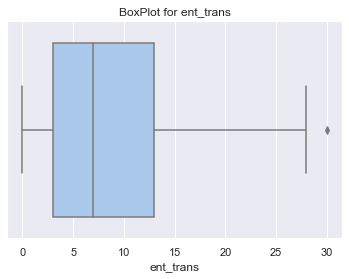

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


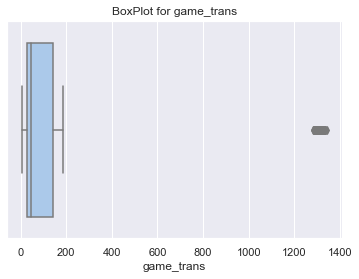

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


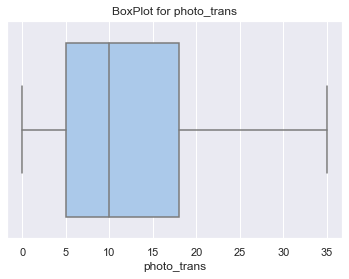

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


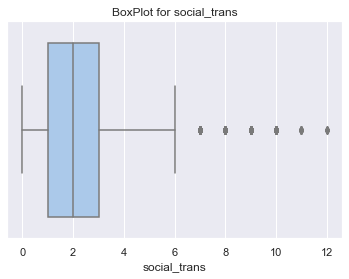

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


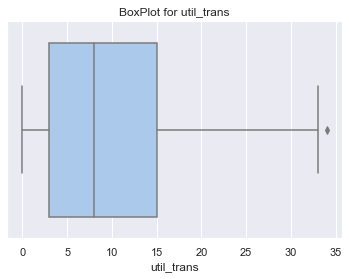

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


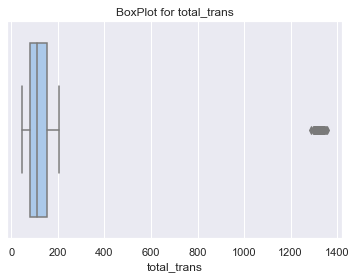

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


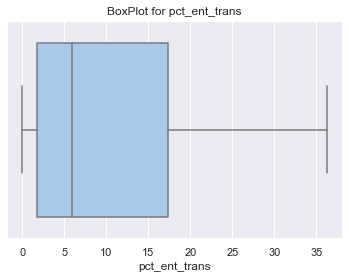

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


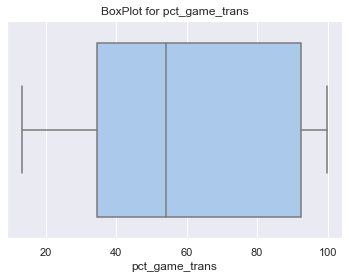

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


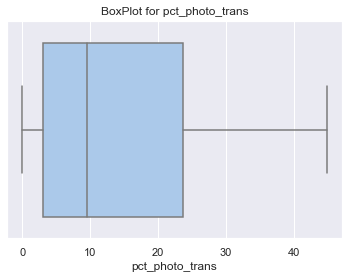

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


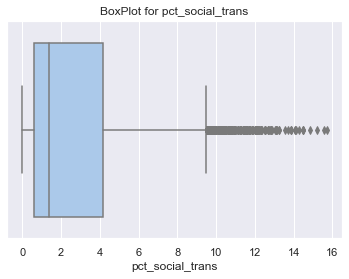

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


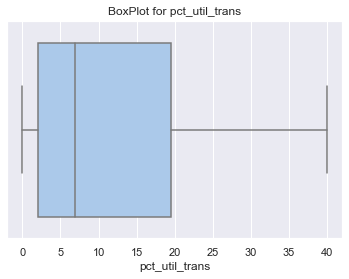

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


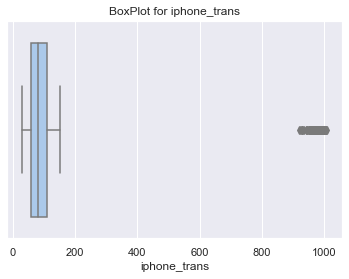

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


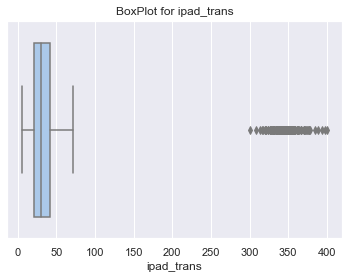

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


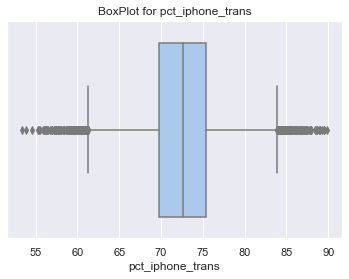

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


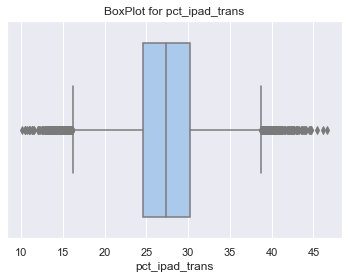

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


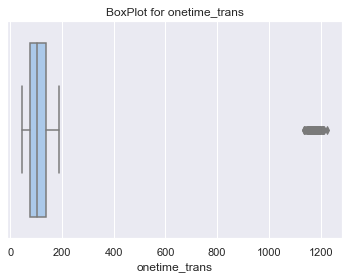

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


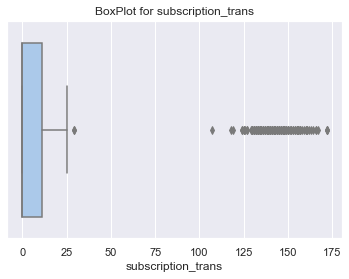

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


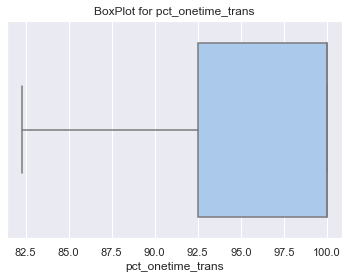

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


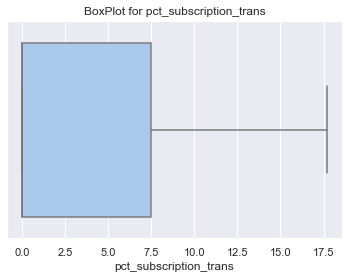

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


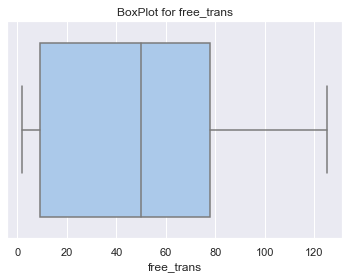

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


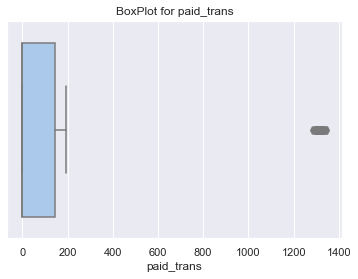

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


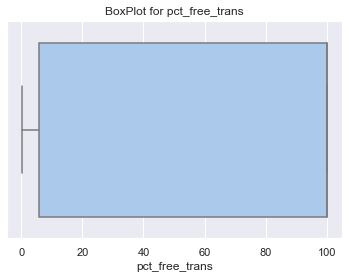

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


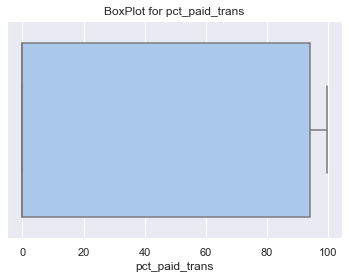

/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


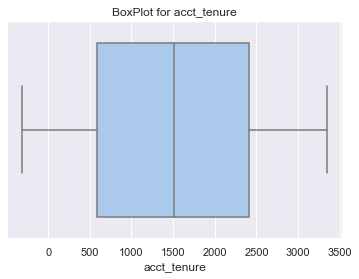

In [122]:
num_vars = ['ent_trans', 'game_trans', 'photo_trans',
       'social_trans', 'util_trans', 'total_trans', 'pct_ent_trans',
       'pct_game_trans', 'pct_photo_trans', 'pct_social_trans',
       'pct_util_trans', 'iphone_trans', 'ipad_trans', 'pct_iphone_trans',
       'pct_ipad_trans', 'onetime_trans', 'subscription_trans',
       'pct_onetime_trans', 'pct_subscription_trans', 'free_trans',
       'paid_trans', 'pct_free_trans', 'pct_paid_trans', 'acct_tenure']

# visualize the distribution for the newly generated fields
for i in num_vars:
    sns.boxplot(user_cluster_segmentation[i], palette='pastel')
    plt.title('BoxPlot for {}'.format(i))
    plt.show()

In [123]:
from sklearn.preprocessing import StandardScaler 

# Scale the distributions of the fields
scaler = StandardScaler()

cluster_vars = ['ent_trans', 'game_trans', 'photo_trans',
       'social_trans', 'util_trans', 'total_trans', 'pct_ent_trans',
       'pct_game_trans', 'pct_photo_trans', 'pct_social_trans',
       'pct_util_trans', 'iphone_trans', 'ipad_trans', 'pct_iphone_trans',
       'pct_ipad_trans', 'onetime_trans', 'subscription_trans',
       'pct_onetime_trans', 'pct_subscription_trans', 'free_trans',
       'paid_trans', 'pct_free_trans', 'pct_paid_trans', 'acct_tenure']

# Scale the data for clustering and PCA
user_cluster_df_scaled = scaler.fit_transform(user_cluster_segmentation[cluster_vars])
scaled_fields_df = pd.DataFrame(user_cluster_df_scaled, columns=cluster_vars)
scaled_fields_df = pd.concat([user_cluster_segmentation['PMOF_ind'].reset_index(), scaled_fields_df], axis=1)
scaled_fields_df = scaled_fields_df.drop(columns=['index'])


## Applying PCA

In [124]:
# Step 1 scaled data
scaled_fields_df.head()

,PMOF_ind,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,pct_photo_trans,...,pct_ipad_trans,onetime_trans,subscription_trans,pct_onetime_trans,pct_subscription_trans,free_trans,paid_trans,pct_free_trans,pct_paid_trans,acct_tenure
0,1.0,-0.512882,0.569512,-0.732945,-1.111096,-1.362499,0.415742,-0.766697,1.013438,-0.884973,...,-0.369681,0.403569,0.486781,-0.913007,0.913007,-0.981755,0.647649,-1.004965,1.004965,1.299267
1,1.0,-0.675769,0.366497,-0.732945,-0.089639,-0.920992,0.233309,-0.804625,0.888304,-0.842651,...,0.333443,0.281718,-0.119420,0.068927,-0.068927,-1.038829,0.514831,-1.020475,1.020475,0.203330
2,1.0,-1.001544,0.521175,-1.257659,-0.600368,-0.626653,0.351354,-0.983597,1.026502,-1.111304,...,0.904160,0.330459,0.486781,-0.983667,0.983667,-1.038829,0.612231,-1.027912,1.027912,0.728962
3,1.0,-0.349994,0.443836,-0.077053,-0.089639,-1.068161,0.383548,-0.682545,0.788609,-0.583198,...,-0.550027,0.440125,-0.032820,-0.011480,0.011480,-1.010292,0.629940,-1.016226,1.016226,1.278356
4,1.0,-0.838656,0.463171,-1.126481,-0.089639,-0.920992,0.297697,-0.898259,0.995906,-1.045061,...,-0.394792,0.342644,-0.032820,-0.060211,0.060211,-1.010292,0.559104,-1.010277,1.010277,1.047382


In [125]:
scaled_fields_df.groupby('PMOF_ind').count()

,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,pct_photo_trans,pct_social_trans,...,pct_ipad_trans,onetime_trans,subscription_trans,pct_onetime_trans,pct_subscription_trans,free_trans,paid_trans,pct_free_trans,pct_paid_trans,acct_tenure
PMOF_ind,,,,,,,,,,,,,,,,,,,,,
0.0,14993,14993,14993,14993,14993,14993,14993,14993,14993,14993,...,14993,14993,14993,14993,14993,14993,14993,14993,14993,14993
1.0,14982,14982,14982,14982,14982,14982,14982,14982,14982,14982,...,14982,14982,14982,14982,14982,14982,14982,14982,14982,14982


In [126]:
# Step 2: Find the covariance Matrix:

cov_matrix = np.cov(scaled_fields_df.T)
print(cov_matrix.shape)
print('Covariance Matrix:', cov_matrix)

(25, 25)
Covariance Matrix: [[ 0.25000831 -0.44188726  0.29973627 -0.44686759 -0.32511416 -0.44710016
   0.22762118 -0.46340255  0.49491551 -0.47166466 -0.37091364 -0.46815794
   0.22075434  0.24025183 -0.06335554  0.06335554  0.21957666  0.2763213
  -0.46348326  0.46348326 -0.49177712  0.34039933 -0.49992847  0.49992847
   0.43063988]
 [-0.44188726  1.00003336 -0.53037362  0.78625986  0.57667005  0.79433193
  -0.38849948  0.97692988 -0.89647896  0.79824755  0.63229669  0.80033636
  -0.37746905 -0.40819825  0.09069751 -0.09069751 -0.37239024 -0.48852765
   0.82122323 -0.82122323  0.90156317 -0.6002887   0.88340939 -0.88340939
  -0.75864671]
 [ 0.29973627 -0.53037362  1.00003336 -0.53667874 -0.38830007 -0.53648352
   0.98396739 -0.57048104  0.61128332 -0.5848018  -0.45991596 -0.57683753
   0.9791178   0.97163566 -0.05448293  0.05448293  0.97991295  0.97615634
  -0.6015086   0.6015086  -0.58548723  0.99354078 -0.60597914  0.60597914
   0.51648779]
 [-0.44686759  0.78625986 -0.53667874  1

In [127]:
# Step 3: Calculate the eigenvalues and eigenvectors:

eig_val, eig_vec = np.linalg.eig(cov_matrix)
print(len(eig_val))
print(eig_vec.shape)

25
(25, 25)


In [128]:
print('Eigen Vectors:', eig_vec)
print('Eigen Values:', eig_val)

Eigen Vectors: [[-1.20006915e-01+0.00000000e+00j -6.63787370e-02+0.00000000e+00j
   6.13190933e-03+0.00000000e+00j  2.98136301e-02+0.00000000e+00j
   5.60923419e-03+0.00000000e+00j  2.24148254e-03+0.00000000e+00j
   1.75128406e-02+0.00000000e+00j -1.37166547e-03+0.00000000e+00j
  -1.59559883e-01+0.00000000e+00j -1.51251334e-01+0.00000000e+00j
   2.75659198e-02+0.00000000e+00j -1.03416097e-02+0.00000000e+00j
  -8.95482512e-03+0.00000000e+00j  6.32972010e-03+0.00000000e+00j
  -2.30410623e-02+0.00000000e+00j -2.79588430e-01+0.00000000e+00j
   9.22982275e-01+0.00000000e+00j -6.44022599e-04+0.00000000e+00j
   3.01207020e-12+0.00000000e+00j -1.08395002e-12+0.00000000e+00j
  -1.37824919e-12+0.00000000e+00j -4.00329146e-12+1.60244113e-12j
  -4.00329146e-12-1.60244113e-12j -1.34039780e-11+0.00000000e+00j
  -7.35980873e-12+0.00000000e+00j]
 [ 2.16322890e-01+0.00000000e+00j  1.33434277e-01+0.00000000e+00j
  -3.21775348e-02+0.00000000e+00j -1.04641576e-01+0.00000000e+00j
   6.39416760e-01+0.000000

In [129]:
# Making the Eigen Pairs:

eigen_pairs = [(eig_val[i], eig_vec[:,i]) for i in range(len(eig_val))]
eigen_pairs_sorted = sorted(eigen_pairs, reverse = True)

In [130]:
# Step 4: Sort the Eigen Vectors and Eigen Values

eig_val_sorted = [eigen_pairs_sorted[i][0] for i in range(len(eig_val))]
eig_vec_sorted = [eigen_pairs_sorted[i][1] for i in range(len(eig_val))]

In [131]:
# Step 5: Calculating Cumulative Variance Explained:

tot = np.sum(eig_val)
exp_var = [(i/tot)*100 for i in sorted(eig_val, reverse = True)]   # explained variance
tot_var = np.cumsum(exp_var)                                       # total variance explained
print('Cumulative Variance explained', tot_var)

Cumulative Variance explained [ 65.02280539+0.0000000e+00j  81.8121673 +0.0000000e+00j
  90.05439708+0.0000000e+00j  94.00753246+0.0000000e+00j
  95.54103768+0.0000000e+00j  96.95794904+0.0000000e+00j
  98.15674577+0.0000000e+00j  99.22560591+0.0000000e+00j
  99.66513605+0.0000000e+00j  99.85881331+0.0000000e+00j
  99.9161365 +0.0000000e+00j  99.94100864+0.0000000e+00j
  99.96176344+0.0000000e+00j  99.98070619+0.0000000e+00j
  99.99459037+0.0000000e+00j  99.99978443+0.0000000e+00j
  99.99999984+0.0000000e+00j 100.        +0.0000000e+00j
 100.        +8.2404672e-17j 100.        +0.0000000e+00j
 100.        +0.0000000e+00j 100.        +0.0000000e+00j
 100.        +0.0000000e+00j 100.        +0.0000000e+00j
 100.        +0.0000000e+00j]


/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/Users/justinwu/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


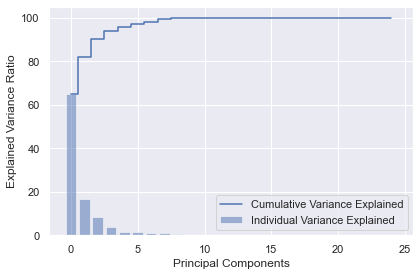

In [132]:
# Plotting the Summary Plot of the Cumulative Variance Explained:

plt.bar(range(25), exp_var, alpha=0.50, align = 'center', label='Individual Variance Explained')
plt.step(range(25), tot_var, where ='mid', label='Cumulative Variance Explained')
plt.ylabel('Explained Variance Ratio')
plt.xlabel('Principal Components')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

## PCA Using sklearn
As we don't know how many components we want hence will start with all the 17 features and will see post fitting the model the eigen values i.e. the explained variance captured by each of the new components (or eigen vectors).

In [133]:
from sklearn.decomposition import PCA
pca_model = PCA(n_components=25)
X_PCA = pca_model.fit_transform(scaled_fields_df)

In [134]:
X_PCA.shape

(29975, 25)

In [135]:
# Cumulative Variance explained:
pca_var = pca_model.explained_variance_ratio_
np.cumsum(pca_var)

array([0.65022805, 0.81812167, 0.90054397, 0.94007532, 0.95541038,
       0.96957949, 0.98156746, 0.99225606, 0.99665136, 0.99858813,
       0.99916136, 0.99941009, 0.99961763, 0.99980706, 0.9999459 ,
       0.99999784, 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ])

In [136]:
# Cumulative Variance explains
var1 = np.cumsum(np.round(pca_model.explained_variance_ratio_, decimals=6)*100)
var1

array([ 65.0228,  81.8122,  90.0544,  94.0075,  95.541 ,  96.9579,
        98.1567,  99.2256,  99.6651,  99.8588,  99.9161,  99.941 ,
        99.9618,  99.9807,  99.9946,  99.9998, 100.    , 100.    ,
       100.    , 100.    , 100.    , 100.    , 100.    , 100.    ,
       100.    ])

In [137]:
# Summary table showing the Eigen Vectors, Eigen Values and the variance explained by each of the component(eigenvector)

vec_val = pd.DataFrame({'Eigen_Values':pca_model.explained_variance_, 'Cumulative_Variance':var1}, 
                       index=range(1,26)).round(4)
vec_val

,Eigen_Values,Cumulative_Variance
1,15.7686,65.0228
2,4.0716,81.8122
3,1.9988,90.0544
4,0.9587,94.0075
5,0.3719,95.5410
6,0.3436,96.9579
7,0.2907,98.1567
8,0.2592,99.2256
9,0.1066,99.6651
10,0.0470,99.8588


In [139]:
### PCA with 3 components:

PCA_3 = PCA(n_components=3)
X_PCA_3 = PCA_3.fit_transform(scaled_fields_df)

In [140]:
PC = pd.DataFrame(X_PCA_3, columns=['PC1 PC2 PC3'.split()])
PC

,PC1,PC2,PC3
0,3.886259,-0.754379,-0.743669
1,2.572172,-0.701353,0.331430
2,3.835449,-0.810368,1.077023
3,2.640295,-0.377005,-0.915953
4,3.038639,-0.778600,-0.740361
...,...,...,...
29970,-3.504609,0.444708,-2.062469
29971,-3.823282,0.462457,0.498986
29972,-4.498276,0.981252,0.818117
29973,-3.373181,0.301321,0.526728


In [141]:
cluster_vars = ['PMOF_ind', 'ent_trans', 'game_trans', 'photo_trans',
       'social_trans', 'util_trans', 'total_trans', 'pct_ent_trans',
       'pct_game_trans', 'pct_photo_trans', 'pct_social_trans',
       'pct_util_trans', 'iphone_trans', 'ipad_trans', 'pct_iphone_trans',
       'pct_ipad_trans', 'onetime_trans', 'subscription_trans',
       'pct_onetime_trans', 'pct_subscription_trans', 'free_trans',
       'paid_trans', 'pct_free_trans', 'pct_paid_trans', 'acct_tenure']

PC_with_all_variables = pd.DataFrame(PCA_3.components_.T, columns = ['PC_'+str(i) for i in range(1,4)], index = cluster_vars)
PC_with_all_variables

,PC_1,PC_2,PC_3
PMOF_ind,0.120007,-0.066379,-0.006132
ent_trans,-0.216323,0.133434,0.032178
game_trans,0.201171,0.297229,-0.005308
photo_trans,-0.218035,0.133477,0.013978
social_trans,-0.166885,0.121883,0.014236
util_trans,-0.218526,0.134186,0.015456
total_trans,0.171781,0.361996,-0.001202
pct_ent_trans,-0.225604,0.121297,0.029160
pct_game_trans,0.241263,-0.128889,-0.018709
pct_photo_trans,-0.229024,0.118618,0.012651


In [142]:
# Variance explained by each of the Component:

pd.Series(PCA_3.explained_variance_ratio_*100, index = ['PC_' + str(i) for i in range(1,4)])

PC_1    65.022805
PC_2    16.789362
PC_3     8.242230
dtype: float64

In [143]:
# Estimate the rank of all the features based on their rank within the PCs and the PC's rank

PC_with_all_variables_rank = None
PC_with_all_variables_rank = PC_with_all_variables.copy()

# weigh the rank of each field within a PC by the PCs explained variance
PC_with_all_variables_rank['PC1_importances'] = np.abs(PC_with_all_variables_rank['PC_1']).rank() * 0.650228 # 15.7686 #Pc1 eiganval
PC_with_all_variables_rank['PC2_importances'] = np.abs(PC_with_all_variables_rank['PC_2']).rank() * (0.818122 - 0.650228) # 4.0716 #Pc2 eiganval
PC_with_all_variables_rank['PC3_importances'] = np.abs(PC_with_all_variables_rank['PC_3']).rank() * (0.900544 - 0.818122)# 1.9988 #Pc3 eiganval

# caculate final rank by adding the field's rank across PCs
PC_with_all_variables_rank['rank'] = PC_with_all_variables_rank['PC1_importances']\
                                    + PC_with_all_variables_rank['PC2_importances']\
                                    + PC_with_all_variables_rank['PC3_importances']

PC_with_all_variables_rank = PC_with_all_variables_rank.reset_index().rename(columns = {'index':'field'})


PC_with_all_variables_rank.sort_values('rank', ascending=False)


,field,PC_1,PC_2,PC_3,PC1_importances,PC2_importances,PC3_importances,rank
8,pct_game_trans,0.241263,-0.128889,-0.018709,16.255700,2.350516,1.566018,20.172234
20,free_trans,-0.237596,0.140521,0.014491,14.305016,3.022092,1.236330,18.563438
22,pct_free_trans,-0.240574,0.128812,0.012292,15.280358,2.098675,0.700587,18.079620
23,pct_paid_trans,0.240574,-0.128812,-0.012292,15.280358,2.098675,0.700587,18.079620
19,pct_subscription_trans,0.231600,-0.099078,-0.018122,13.329674,0.755523,1.483596,15.568793
18,pct_onetime_trans,-0.231600,0.099078,0.018122,13.329674,0.755523,1.401174,15.486371
5,util_trans,-0.218526,0.134186,0.015456,10.403648,2.854198,1.318752,14.576598
9,pct_photo_trans,-0.229024,0.118618,0.012651,12.354332,1.175258,0.906642,14.436232
11,pct_util_trans,-0.227621,0.121320,0.013673,11.704104,1.511046,0.989064,14.204214
7,pct_ent_trans,-0.225604,0.121297,0.029160,11.053876,1.343152,1.648440,14.045468


## Variable Reduction (Factor Analysis)
Using factor loadings finding out which of the variables have the maximum contirbution in each of the components.

Loadings are the correlation between the original variables and the unit-scaled components. We find the loadings by:

Loadings=Eigenvectors * sqrt(Eigenvalues)

This results in a loading matrix.

In [144]:
Loadings = pd.DataFrame((pca_model.components_.T * np.sqrt(pca_model.explained_variance_)).T, index= cluster_vars
                        , columns=['PC1 PC2 PC3 PC4 PC5 PC6 PC7 PC8 PC9 PC10 PC11 PC12 PC13 PC14 PC15 PC16 PC18 PC19 PC20 PC21 PC22 PC23 PC24 PC25 PC26'.split()])


In [145]:
pca_model.explained_variance_

array([1.57685563e+01, 4.07155609e+00, 1.99880740e+00, 9.58667310e-01,
       3.71887423e-01, 3.43612468e-01, 2.90717905e-01, 2.59207230e-01,
       1.06589616e-01, 4.69683011e-02, 1.39013372e-02, 6.03169682e-03,
       5.03320537e-03, 4.59377230e-03, 3.36702392e-03, 1.25960275e-03,
       5.22383271e-05, 3.88202609e-08, 9.68163662e-31, 8.13142532e-31,
       5.30291624e-31, 3.94467212e-31, 8.84807450e-32, 2.90118794e-32,
       6.20787607e-33])

In [146]:
Loadings

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC16,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26
PMOF_ind,4.765432e-01,-8.590104e-01,7.988417e-01,-8.658111e-01,-6.626961e-01,-8.677585e-01,6.821351e-01,-8.958653e-01,9.580454e-01,-9.094472e-01,...,1.312020e-01,6.668365e-01,7.654721e-01,-9.196758e-01,9.196758e-01,-9.434836e-01,8.555760e-01,-9.553124e-01,9.553124e-01,8.345209e-01
ent_trans,-1.339397e-01,2.692450e-01,5.997514e-01,2.693316e-01,2.459362e-01,2.707611e-01,7.304399e-01,2.447549e-01,-2.600727e-01,2.393489e-01,...,-7.155870e-02,7.426158e-01,6.167162e-01,1.999207e-01,-1.999207e-01,2.835449e-01,5.147119e-01,2.599189e-01,-2.599189e-01,-2.457438e-01
game_trans,-8.669243e-03,4.549234e-02,-7.503915e-03,1.976232e-02,2.012725e-02,2.185120e-02,-1.699659e-03,4.122660e-02,-2.645093e-02,1.788640e-02,...,9.887144e-01,-4.379165e-04,-1.060366e-02,2.562110e-02,-2.562110e-02,2.048713e-02,-7.759115e-03,1.737773e-02,-1.737773e-02,-1.456708e-02
photo_trans,2.919099e-02,-1.024562e-01,-6.251196e-03,-1.050909e-01,6.980239e-01,-1.069844e-01,-1.542077e-02,-1.027621e-01,4.809548e-02,-1.033589e-01,...,1.404115e-03,-1.786688e-02,2.537903e-03,-7.031881e-02,7.031881e-02,-5.299153e-02,3.718381e-03,-5.807195e-02,5.807195e-02,6.988539e-02
social_trans,3.420655e-03,3.899328e-01,-3.933984e-03,-2.214497e-01,5.064393e-03,-9.220355e-02,-3.410482e-03,3.357335e-01,2.616403e-03,-1.919432e-01,...,-8.208424e-03,-5.919236e-03,1.454632e-02,-4.026975e-02,4.026975e-02,-2.259859e-04,-2.743888e-03,-6.840601e-03,6.840601e-03,3.614600e-02
util_trans,1.313923e-03,-6.608747e-02,-1.052748e-03,-2.690104e-01,2.139426e-03,3.484695e-01,-2.074770e-03,-5.827274e-02,2.715504e-03,-2.235648e-01,...,1.202004e-03,-3.370560e-03,7.211706e-03,-1.848552e-02,1.848552e-02,-2.047044e-03,-1.076750e-03,-2.602550e-03,2.602550e-03,-1.091460e-02
total_trans,-9.442619e-03,4.884203e-02,-3.869536e-02,1.159000e-01,1.354816e-02,7.206900e-02,-2.471487e-02,2.152919e-02,-4.789741e-02,7.548372e-02,...,3.234938e-03,-4.960944e-02,1.531321e-01,-3.242339e-01,3.242339e-01,4.448344e-02,-3.419463e-02,1.855288e-02,-1.855288e-02,-1.255673e-01
pct_ent_trans,6.983478e-04,6.589224e-02,-1.725641e-02,1.187538e-01,2.705242e-02,1.081354e-01,3.353975e-03,1.444580e-02,-3.770059e-02,5.089535e-02,...,-2.107722e-03,3.153885e-03,4.651176e-03,-3.378273e-02,3.378273e-02,4.505540e-02,-1.121234e-02,-1.505756e-03,1.505756e-03,4.654831e-01
pct_game_trans,5.209321e-02,1.095394e-01,-1.207483e-02,1.239019e-01,7.974834e-02,1.145739e-01,1.397927e-02,-5.744315e-02,6.517042e-02,-6.361336e-02,...,-2.707389e-03,2.790606e-02,-8.551952e-02,1.282310e-02,-1.282310e-02,4.372688e-02,-2.033145e-03,-1.042772e-01,1.042772e-01,-6.401416e-02
pct_photo_trans,3.277945e-02,1.127912e-02,-6.533581e-03,2.224921e-02,-1.186777e-02,1.471458e-02,-3.865794e-03,5.428583e-02,-5.828721e-02,5.720908e-02,...,-7.856509e-04,-3.178202e-03,-8.608651e-03,7.939199e-03,-7.939199e-03,-1.401903e-01,4.030837e-02,-6.834558e-02,6.834558e-02,-1.252098e-02


## Clustering

Performing Clustering on the 7 components which were found after reducing the dimensionality using PCA.

Finding the optimal clusters using:

1) K-Means\ 2) Hierarchical Clustering (Agglomerative)\ 3) Silhouette Score\ 4) Plotting Elbow Method\ 5) Plotting Dendrogram\ 6) Finding the Segment Distributuion for each cluster\ 7) Performing Profiling

In [147]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import linkage, cophenet, dendrogram
from scipy.spatial.distance import pdist

Average-linkage is where the distance between each pair of observations in each cluster are added up and divided by the number of pairs to get an average inter-cluster distance



In [280]:
# Step 1: Finding the Cophenetic Distance Correlation Coefficient for different Linkages

for i  in ['single', 'complete', 'average']:
    print('Linkage is', i)
    Z= linkage(X_PCA_4, method = i , metric = 'euclidean')
    c , coph_dist = cophenet(Z, pdist(X_PCA_3))
    print('Cophenetic Distance Correlation Coefficient for euclidean distance is\t:', c)
    
    print()
    
Z= linkage(X_PCA_3, 'ward')
c , coph_dist = cophenet(Z, pdist(X_PCA_4))
print('Cophenetic Distance Correlation Coefficient for ward linkage is \t:', c)

Linkage is single
Cophenetic Distance Correlation Coefficient for euclidean distance is	: 0.8709846357167129

Linkage is complete
Cophenetic Distance Correlation Coefficient for euclidean distance is	: 0.9113144967642772

Linkage is average
Cophenetic Distance Correlation Coefficient for euclidean distance is	: 0.9378020668469124

Cophenetic Distance Correlation Coefficient for ward linkage is 	: 0.5557568133528671


For the Agglomerative Clustering, the Cophenet distance correlation coefficient helps in deciding which linkage method is the most beneficial for the dataset. The higher the coefficient, the better it is. From the above, the best method is Average euclidean distance.

### Step 2: Finding the Optimal clusters using K-Means, Silhouette Coefficient Score for both K-Means and Agglomerative Clustering

In [148]:
# Step 2: Finding the Optimal clusters using KMeans, Silhouette Coefficient Score for both KMeans and Agglomerative Clustering

wcss = []
sil_kmeans = []
sil_agc = []

for i in range(2,9):
    
    # K-Means Clustering:
    kmeans = KMeans(n_clusters = i, n_init = 100, init='k-means++', random_state = 0)
    kmeans.fit(X_PCA_3)
    
     # Inertia and Silhouette Score for Clusters using K-Means:
    in_km = kmeans.inertia_
    wcss.append(in_km)
    sil_km = silhouette_score(X_PCA_3, kmeans.labels_)
    sil_kmeans.append(sil_km)
    
    # Agglomerative Clusters and its Silhouette Score
    agc = AgglomerativeClustering(n_clusters = i, affinity = 'euclidean', linkage = 'average')
    agc.fit(X_PCA_3)
    sil_ag = silhouette_score(X_PCA_3, agc.labels_)
    sil_agc.append(sil_ag)
    
    print('Number of clusters:', i)
    print('KMeans Inertia', in_km)
    print('Silhouette Score for KMeans:', sil_km)
    print('Silhouette Score for AGC(HCA):', sil_ag)
    print()

Number of clusters: 2
KMeans Inertia 216499.0016398359
Silhouette Score for KMeans: 0.7475818615122428
Silhouette Score for AGC(HCA): 0.8549572248026649

Number of clusters: 3
KMeans Inertia 69774.3410982867
Silhouette Score for KMeans: 0.7664722272437487
Silhouette Score for AGC(HCA): 0.7664722272437487

Number of clusters: 4
KMeans Inertia 44656.17476682452
Silhouette Score for KMeans: 0.6243781234623824
Silhouette Score for AGC(HCA): 0.6339735247805284

Number of clusters: 5
KMeans Inertia 31673.865592482784
Silhouette Score for KMeans: 0.44146182864199335
Silhouette Score for AGC(HCA): 0.48048948533394636

Number of clusters: 6
KMeans Inertia 24826.317522904978
Silhouette Score for KMeans: 0.4076631621850055
Silhouette Score for AGC(HCA): 0.4292478818713673

Number of clusters: 7
KMeans Inertia 21242.81683769876
Silhouette Score for KMeans: 0.371730272222121
Silhouette Score for AGC(HCA): 0.4558500040099431

Number of clusters: 8
KMeans Inertia 18323.404338893655
Silhouette Score f

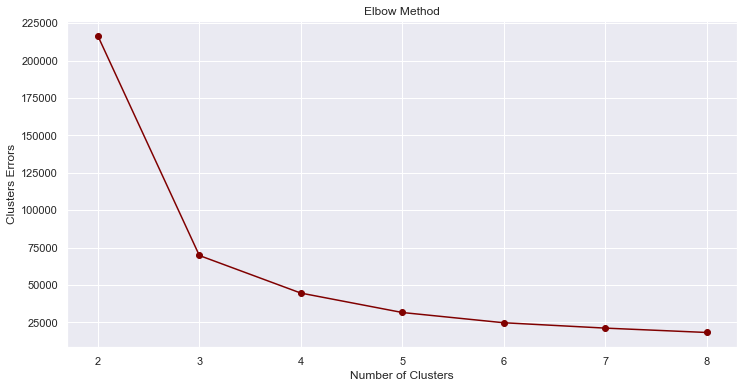

In [150]:
# # Plotting graph of Elbow Method 

plt.figure(figsize=(12,6))
plt.plot(range(2,9), wcss, c ='#800000', marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Clusters Errors')
plt.show()

Inference of Elbow Method:


The sum of squared distances of each data point within a cluster from its respective centroid is called the inertia. The K at which the inertia stops to drop significantly (using the above elbow method) is the best K.

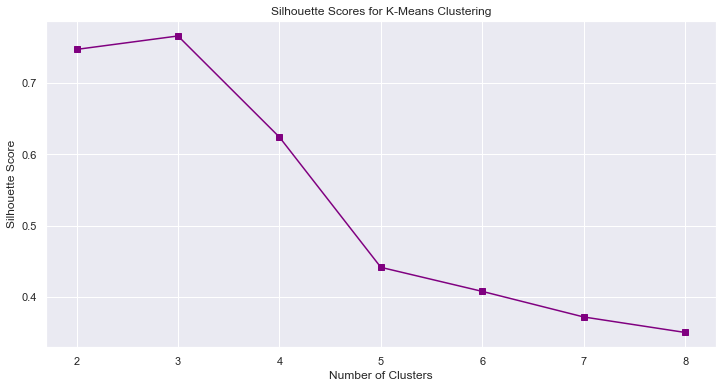

In [152]:
# Plotting the Silhouette Score for the clusters found from K-Means and Agglomerative Clustering

plt.figure(figsize=(12,6))
plt.plot(range(2,9), sil_kmeans, marker='s', c='purple')
plt.title('Silhouette Scores for K-Means Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

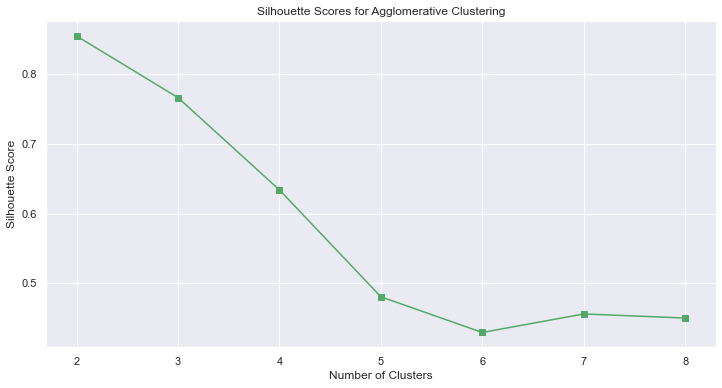

In [153]:
# Plotting the Silhouette Score for the clusters found from K-Means and Agglomerative Clustering

plt.figure(figsize=(12,6))
plt.plot(range(2,9), sil_agc, marker='s', c='g')
plt.title('Silhouette Scores for Agglomerative Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

Silhouette Coefficient or silhouette score is a metric used to calculate the goodness of a clustering technique. Its value ranges from -1 to 1. 1: Means clusters are well apart from each other and clearly distinguished.

### Applying Clustering and visualizing the spread of the data

In [154]:
# Now we can fit the model with this code

#K-Means Clusters:   For K= 3
kmeans_3 = KMeans(n_clusters = 3, n_init = 100, init='k-means++', random_state = 0)
kmeans_3.fit(X_PCA_3)

# Taking into each dataframes
df_pca = pd.DataFrame(X_PCA_3)
y_lab = pd.Series(kmeans_3.labels_, name = 'y') # labels for clusters

#concatenating the dataframe:
df_final = pd.concat([df_pca, y_lab], axis = 1)


In [155]:
df_final.head()

,0,1,2,y
0,3.886259,-0.754379,-0.743669,0
1,2.572172,-0.701353,0.331430,0
2,3.835449,-0.810368,1.077023,0
3,2.640295,-0.377005,-0.915953,0
4,3.038639,-0.778600,-0.740361,0


In [156]:
import plotly.express as px

fig = px.scatter_3d(df_final, x=0, y=1, z=2,
              color='y',  size_max=18, #size='y',
              symbol='y', opacity=0.7)

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

In [157]:
kmeans_3.cluster_centers_

array([[ 3.62691526e+00, -8.12288771e-01, -2.55108557e-02],
       [-3.78315704e+00,  5.40313189e-01,  2.45032017e-02],
       [ 1.95097761e+01,  2.63130094e+01,  7.33367273e-02]])

In [158]:
def map_centroids(centroids, rank_df):
    """
    Take's a cluster's centroid developed based on 3 PCs
    Maps these centroids to the rough approximation of the all original field's distributions
    """
    
    cluster_vars = ['ent_trans', 'game_trans', 'photo_trans',
       'social_trans', 'util_trans', 'total_trans', 'pct_ent_trans',
       'pct_game_trans', 'pct_photo_trans', 'pct_social_trans',
       'pct_util_trans', 'iphone_trans', 'ipad_trans', 'pct_iphone_trans',
       'pct_ipad_trans', 'onetime_trans', 'subscription_trans',
       'pct_onetime_trans', 'pct_subscription_trans', 'free_trans',
       'paid_trans', 'pct_free_trans', 'pct_paid_trans', 'acct_tenure']
    
    k = len(centroids)
    
    if k == 3:
        scaled_centroid = PCA_3.inverse_transform(centroids)
        scaled_centroid_df = pd.DataFrame (scaled_centroid.T, columns=[f"C{n}" for n in range(1,k+1)])
        scaled_centroid_df2 = scaled_centroid_df.copy().drop([0])
        
        raw_centroid_df = scaled_centroid_df2.apply(lambda x: scaler.inverse_transform(x))
        raw_centroid_df = pd.concat([pd.DataFrame(cluster_vars, index=range(1,25), columns=['field']), raw_centroid_df], axis=1)
        raw_centroid_df = raw_centroid_df.merge(rank_df[['field','rank']], on="field", how='left')


    elif k == 4:
        pass
    
    elif k ==5 : 
        scaled_centroid = PCA_3.inverse_transform(centroids)
        scaled_centroid_df = pd.DataFrame (scaled_centroid.T, columns=[f"C{n}" for n in range(1,k+1)])
        scaled_centroid_df2 = scaled_centroid_df.copy().drop([0])
        
        raw_centroid_df = scaled_centroid_df2.apply(lambda x: scaler.inverse_transform(x))
        raw_centroid_df = pd.concat([pd.DataFrame(cluster_vars, index=range(1,25), columns=['field']), raw_centroid_df], axis=1)
        raw_centroid_df = raw_centroid_df.merge(rank_df[['field','rank']], on="field", how='left')
    
    return raw_centroid_df


In [159]:
# Generate value based on mapped centroids and sort by rank
K3_centroids_df = map_centroids(kmeans_3.cluster_centers_, PC_with_all_variables_rank)
K3_centroids_df.sort_values('rank', ascending = False)

,field,C1,C2,C3,rank
7,pct_game_trans,92.113472,35.010860,101.827677,20.172234
19,free_trans,9.192812,77.573409,10.573905,18.563438
22,pct_paid_trans,93.046839,0.914291,108.377198,18.079620
21,pct_free_trans,6.953161,99.085709,-8.377198,18.079620
18,pct_subscription_trans,7.582544,-0.014616,11.642198,15.568793
17,pct_onetime_trans,92.417456,100.014616,88.357802,15.486371
4,util_trans,3.129272,15.370735,4.288053,14.576598
8,pct_photo_trans,3.309659,23.506059,-1.241825,14.436232
10,pct_util_trans,2.201481,19.605532,-0.835547,14.204214
6,pct_ent_trans,1.867504,17.368700,-0.580336,14.045468


Notes on findings:

 * C2 cluster: one time free trans, no subscriptions, higher on util photo and entertainment. shorter acct tenure


 * C1 and C3 similarities: high proportions of transactions on paid gaming. dont have transactions in any other categories. both ahve long tenures with Apple (~6.5 years, 2400 days)

* C1 and C3 differences: C1 has more one time transactions, C3 has more subscriptions. Volume of C3 games transaction is super large (1.3k in C3 vs. 140 in C1)


Cluster Names:

* C1: Casual Gamers. Note casual > functional

* C2: Functional Users

* C3: Extreme Gamers 








In [160]:
kmeans_3.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [161]:
np.array([f"C{n+1}" for n in kmeans_3.labels_])

array(['C1', 'C1', 'C1', ..., 'C2', 'C2', 'C2'], dtype='<U2')

In [162]:
# Appending Cluster Labels to Original DF
user_cluster_segmentation['cluster_k3'] = np.array([f"C{n+1}" for n in kmeans_3.labels_])

user_cluster_segmentation.head()

,acct_id,PMOF_ind,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,...,onetime_trans,subscription_trans,pct_onetime_trans,pct_subscription_trans,free_trans,paid_trans,pct_free_trans,pct_paid_trans,acct_tenure,cluster_k3
2,9b6d6fbf76504d85,1.0,5.0,148.0,6.0,0.0,0.0,159.0,3.14,93.08,...,147.0,12.0,92.45,7.55,9.0,150.0,5.66,94.34,2876,C1
3,343255370828b380,1.0,4.0,127.0,6.0,2.0,3.0,142.0,2.82,89.44,...,137.0,5.0,96.48,3.52,7.0,135.0,4.93,95.07,1723,C1
6,0fcabb83f967764d,1.0,2.0,143.0,2.0,1.0,5.0,153.0,1.31,93.46,...,141.0,12.0,92.16,7.84,7.0,146.0,4.58,95.42,2276,C1
8,35e8a19533d53afb,1.0,6.0,135.0,11.0,2.0,2.0,156.0,3.85,86.54,...,150.0,6.0,96.15,3.85,8.0,148.0,5.13,94.87,2854,C1
15,c413bad6da754865,1.0,3.0,137.0,3.0,2.0,3.0,148.0,2.03,92.57,...,142.0,6.0,95.95,4.05,8.0,140.0,5.41,94.59,2611,C1


# Profiles for K3 Clusters

In [163]:
# Step 1a: Get the total size of the cluster:
user_cluster_segmentation.cluster_k3.size

# Step 1b: Get the break up of the values in each segment:
# which gives how many observations are there in each of the respective segment:

user_cluster_segmentation.cluster_k3.value_counts()

C2    14993
C1    14832
C3      150
Name: cluster_k3, dtype: int64

In [164]:
pd.Series.sort_index(user_cluster_segmentation.cluster_k3.value_counts())/sum(user_cluster_segmentation.cluster_k3.value_counts())



C1    0.494812
C2    0.500183
C3    0.005004
Name: cluster_k3, dtype: float64

In [165]:
# by using the Sort Index provides:
# the value counts based on the Segment Label (0,1,2 depending upon the K-value) in the index
# and not based on the highest value within the segments

pd.Series.sort_index(user_cluster_segmentation.cluster_k3.value_counts())

C1    14832
C2    14993
C3      150
Name: cluster_k3, dtype: int64

In [167]:
metrics = ['acct_id', 'cohort','total_revenue','paying_user','total_downloads','is_active'
           ,'quality_user', 'weekly_revenue', 'num_weekly_downloads']

# use metrics from prior user segmentation section and apply them to the clustering analysis
user_cluster_segmentation_full = user_cluster_segmentation.merge(user_segmentation[metrics],on='acct_id',how='left')

user_cluster_segmentation_full.head()

,acct_id,PMOF_ind,ent_trans,game_trans,photo_trans,social_trans,util_trans,total_trans,pct_ent_trans,pct_game_trans,...,acct_tenure,cluster_k3,cohort,total_revenue,paying_user,total_downloads,is_active,quality_user,weekly_revenue,num_weekly_downloads
0,9b6d6fbf76504d85,1.0,5.0,148.0,6.0,0.0,0.0,159.0,3.14,93.08,...,2876,C1,2008,61.81,True,28,True,True,80.558824,9.352941
1,343255370828b380,1.0,4.0,127.0,6.0,2.0,3.0,142.0,2.82,89.44,...,1723,C1,2012,82.74,True,33,True,True,63.290625,8.875000
2,0fcabb83f967764d,1.0,2.0,143.0,2.0,1.0,5.0,153.0,1.31,93.46,...,2276,C1,2010,80.79,True,28,True,True,59.090588,9.000000
3,35e8a19533d53afb,1.0,6.0,135.0,11.0,2.0,2.0,156.0,3.85,86.54,...,2854,C1,2008,112.68,True,40,True,True,68.148235,9.176471
4,c413bad6da754865,1.0,3.0,137.0,3.0,2.0,3.0,148.0,2.03,92.57,...,2611,C1,2009,82.79,True,29,True,True,64.350000,9.250000


<AxesSubplot:xlabel='cluster_k3', ylabel='mean_downloads_per_user'>

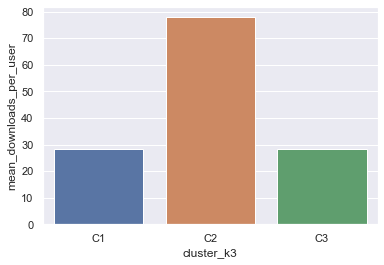

In [173]:
compare_by_cohort(user_cluster_segmentation_full, "cluster_k3", "total_downloads", how='mean')

<AxesSubplot:xlabel='cluster_k3', ylabel='mean_downloads_per_week_per_user'>

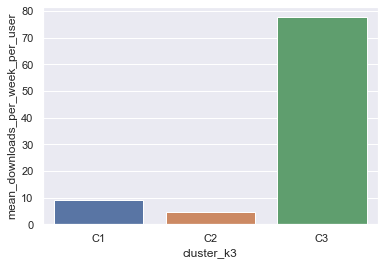

In [168]:
compare_by_cohort(user_cluster_segmentation_full, "cluster_k3", "num_weekly_downloads", how='mean')

<AxesSubplot:xlabel='cluster_k3', ylabel='mean_revenue_per_user'>

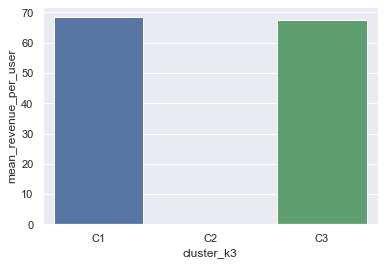

In [171]:
compare_by_cohort(user_cluster_segmentation_full, "cluster_k3", "total_revenue", how='mean')

<AxesSubplot:xlabel='cluster_k3', ylabel='mean_revenue_per_week_per_user'>

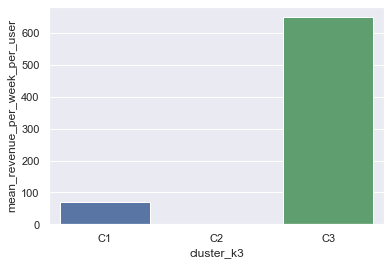

In [172]:
compare_by_cohort(user_cluster_segmentation_full, "cluster_k3", "weekly_revenue", how='mean')

In [170]:
user_cluster_segmentation_full.groupby('cluster_k3').mean().T

cluster_k3,C1,C2,C3
PMOF_ind,1.000000,0.000000,1.000000
ent_trans,2.721885,13.572200,2.653333
game_trans,139.411677,27.104649,1308.820000
photo_trans,4.773261,18.397786,4.646667
social_trans,0.901429,3.448142,0.953333
util_trans,3.180623,15.331621,3.120000
total_trans,150.988875,77.854399,1320.193333
pct_ent_trans,1.802573,17.425109,0.201667
pct_game_trans,92.334785,34.818825,99.138800
pct_photo_trans,3.160421,23.637749,0.352000
